In [ ]:
import csv
import string
import os
import json
import pandas as pd

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from collections import defaultdict
from langdetect import detect
from wordcloud import WordCloud
from nltk.corpus import stopwords

#label font
font = {'family' : 'sans-serif',
        # 'weight' : 'bold',
        'size'   : 16}

matplotlib.rc('font', **font)
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

#color palette
plt.style.use("seaborn-v0_8-colorblind")

#figure size
default_figsize = (10,4)
matplotlib.rcParams["figure.figsize"] = default_figsize

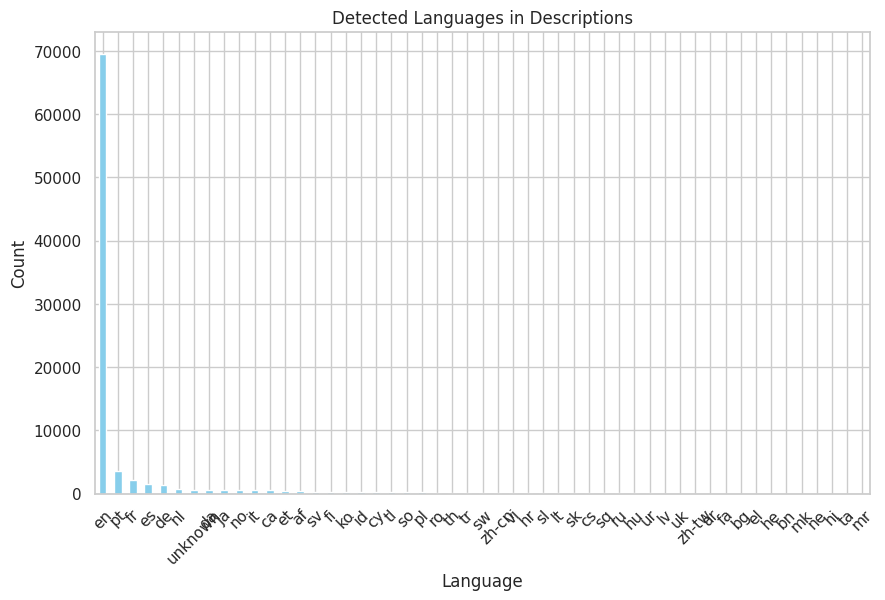

Language Counts:
 language
en         69574
pt          3635
fr          2228
es          1551
de          1332
nl           692
unknown      611
da           600
ja           578
no           561
it           527
ca           504
et           387
af           384
sv           320
fi           288
ko           283
id           247
cy           231
tl           230
so           206
pl           203
ro           167
th           167
tr           151
sw           112
zh-cn         97
vi            82
hr            66
sl            66
lt            59
sk            54
cs            51
sq            49
ru            49
hu            47
ur            29
lv            27
uk            19
zh-tw         19
ar            18
fa            14
bg            12
el            11
he             8
bn             3
mk             1
ne             1
hi             1
ta             1
mr             1
Name: count, dtype: int64


In [7]:
from langdetect import detect, LangDetectException
import pandas as pd

file_path = "../data/starter_packs/starterpacks_newer.csv"
data = pd.read_csv(file_path)

descriptions = data['description'].dropna()

def safe_detect(text):
    try:
        return detect(text)  
    except LangDetectException:
        return "unknown"

filtered_descriptions = descriptions[descriptions.str.strip() != ""]
data['language'] = filtered_descriptions.apply(safe_detect)

language_counts = data['language'].value_counts()

language_counts.plot(kind='bar', figsize=(10, 6), color='skyblue')
plt.title('Detected Languages in Descriptions')
plt.xlabel('Language')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

print("Language Counts:\n", language_counts)

/tmp/ipykernel_1208323/3029928099.py:21: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  filtered_data['week'] = filtered_data['createdAt'].dt.to_period('W')


<Figure size 1200x600 with 0 Axes>

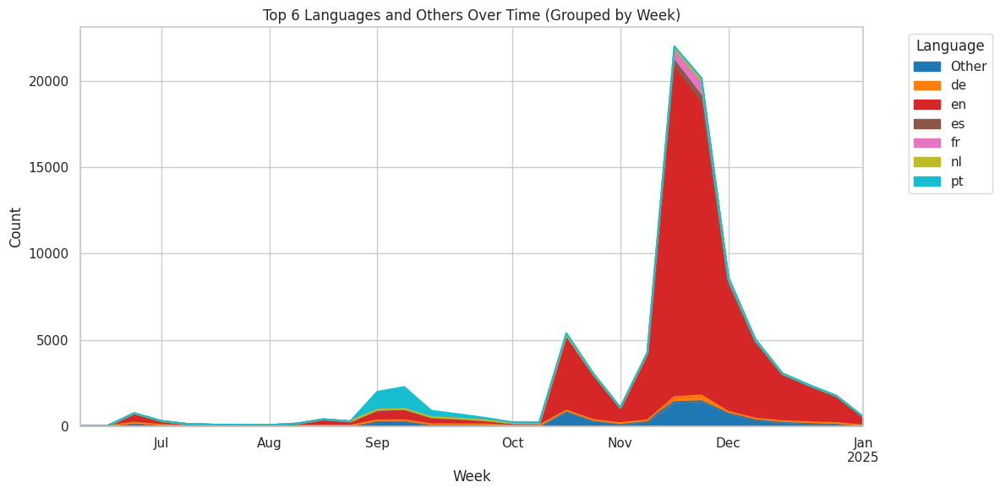

In [10]:
from langdetect import detect, LangDetectException
import pandas as pd
import matplotlib.pyplot as plt

file_path = "../data/starter_packs/starterpacks_newer.csv"
data = pd.read_csv(file_path)
data['createdAt'] = pd.to_datetime(data['createdAt'], errors='coerce')
data = data.dropna(subset=['createdAt'])
data['description'] = data['description'].fillna('').astype(str)

def safe_detect(text):
    try:
        if not text.strip():
            return "unknown"
        return detect(text)
    except LangDetectException:
        return "unknown"

filtered_data = data[data['description'].str.strip() != ""].copy()
filtered_data['language'] = filtered_data['description'].apply(safe_detect)
filtered_data['week'] = filtered_data['createdAt'].dt.to_period('W')
language_counts = filtered_data['language'].value_counts()
top_languages = language_counts.nlargest(6).index
filtered_data['language_grouped'] = filtered_data['language'].apply(
    lambda lang: lang if lang in top_languages else "Other"
)

language_counts_over_time = (
    filtered_data.groupby(['week', 'language_grouped'])
    .size()
    .unstack(fill_value=0)
)

plt.figure(figsize=(12, 6))
language_counts_over_time.plot(
    kind='area',
    stacked=True,
    figsize=(12, 6),
    colormap='tab10'
)

plt.xlabel('Week')
plt.ylabel('Count')
plt.legend(title='Language', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title('Top 6 Languages and Others Over Time (Grouped by Week)')
plt.tight_layout()
plt.show()

/tmp/ipykernel_1208323/777911582.py:21: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  filtered_data['week'] = filtered_data['createdAt'].dt.to_period('W')


<Figure size 1200x600 with 0 Axes>

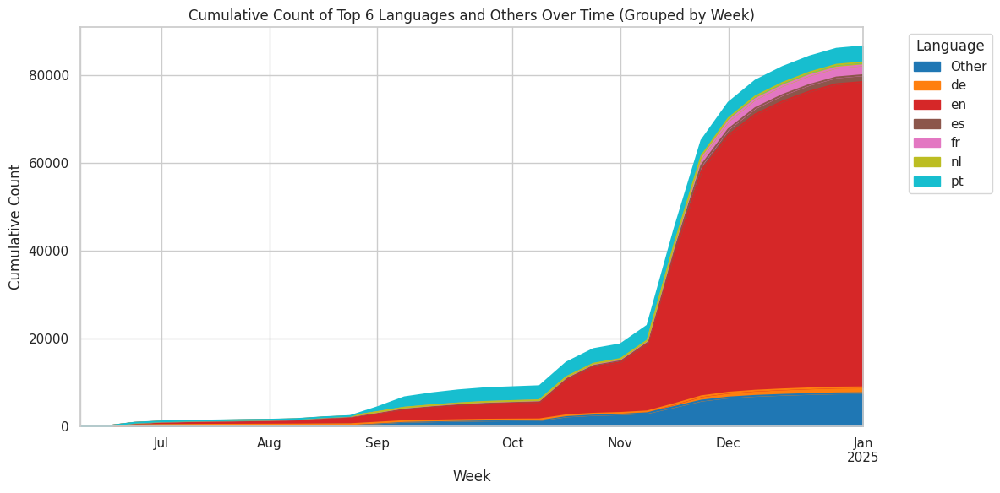

In [12]:
from langdetect import detect, LangDetectException
import pandas as pd
import matplotlib.pyplot as plt

file_path = "../data/starter_packs/starterpacks_newer.csv"
data = pd.read_csv(file_path)
data['createdAt'] = pd.to_datetime(data['createdAt'], errors='coerce')
data = data.dropna(subset=['createdAt'])
data['description'] = data['description'].fillna('').astype(str)

def safe_detect(text):
    try:
        if not text.strip():
            return "unknown"
        return detect(text)
    except LangDetectException:
        return "unknown"

filtered_data = data[data['description'].str.strip() != ""].copy()
filtered_data['language'] = filtered_data['description'].apply(safe_detect)
filtered_data['week'] = filtered_data['createdAt'].dt.to_period('W')
language_counts = filtered_data['language'].value_counts()
top_languages = language_counts.nlargest(6).index
filtered_data['language_grouped'] = filtered_data['language'].apply(
    lambda lang: lang if lang in top_languages else "Other"
)

language_counts_over_time = (
    filtered_data.groupby(['week', 'language_grouped'])
    .size()
    .unstack(fill_value=0)
)

cumulative_counts_over_time = language_counts_over_time.cumsum()

plt.figure(figsize=(12, 6))
cumulative_counts_over_time.plot(
    kind='area',
    stacked=True,
    figsize=(12, 6),
    colormap='tab10'
)

plt.xlabel('Week')
plt.ylabel('Cumulative Count')
plt.legend(title='Language', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title('Cumulative Count of Top 6 Languages and Others Over Time (Grouped by Week)')
plt.tight_layout()
plt.show()

<Figure size 1200x400 with 0 Axes>

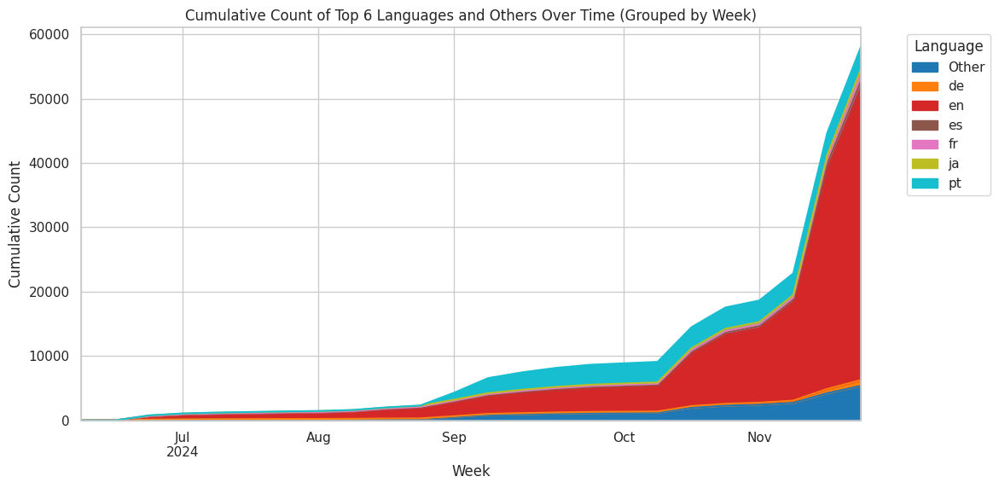

In [ ]:
plt.figure(figsize=(12, 4))
cumulative_counts_over_time.plot(
    kind='area',
    stacked=True,
    figsize=(12, 6),
    colormap='tab10'
)

plt.xlabel('Week')
plt.ylabel('Cumulative Count')
plt.legend(title='Language', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title('Cumulative Count of Top 6 Languages and Others Over Time (Grouped by Week)')
plt.tight_layout()
plt.show()

In [2]:
import pandas as pd

file_path = '../../output_and_test_data/starter_packs/starterpacks_newer.csv'
data = pd.read_csv(file_path)

data['description'] = data['description'].fillna('').astype(str)

total_entries = data.shape[0]

entries_with_descriptions = data[data['description'].str.strip() != ""].shape[0]

entries_without_descriptions = total_entries - entries_with_descriptions

print(f"Total number of entries: {total_entries}")
print(f"Entries with descriptions: {entries_with_descriptions}")
print(f"Entries without descriptions: {entries_without_descriptions}")


Total number of entries: 338329
Entries with descriptions: 86554
Entries without descriptions: 251775


/tmp/ipykernel_159458/3133329855.py:9: FutureWarning: In a future version of pandas, parsing datetimes with mixed time zones will raise an error unless `utc=True`. Please specify `utc=True` to opt in to the new behaviour and silence this warning. To create a `Series` with mixed offsets and `object` dtype, please use `apply` and `datetime.datetime.strptime`
  data['createdAt'] = pd.to_datetime(data['createdAt'], format='ISO8601', errors='coerce')
/tmp/ipykernel_159458/3133329855.py:28: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  filtered_data['week'] = filtered_data['createdAt'].dt.to_period('W')


<Figure size 1200x600 with 0 Axes>

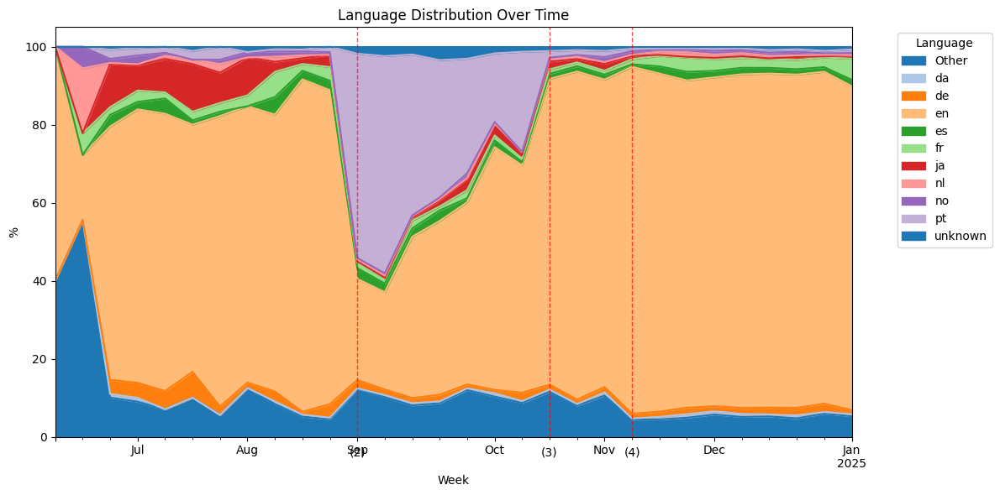

Total Languages Detected: 51


In [4]:
from langdetect import detect, LangDetectException
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

file_path = "../data/starter_packs/starterpacks_newer.csv"
data = pd.read_csv(file_path)

data['createdAt'] = pd.to_datetime(data['createdAt'], format='ISO8601', errors='coerce')
data = data.dropna(subset=['createdAt'])
data['description'] = data['description'].fillna('').astype(str)

def safe_detect(text):
    try:
        if not text.strip():
            return "unknown"
        return detect(text)
    except LangDetectException:
        return "unknown"

filtered_data = data[data['description'].str.strip() != ""].copy()
filtered_data['language'] = filtered_data['description'].apply(safe_detect)

# Ensure 'createdAt' is datetime after filtering
filtered_data['createdAt'] = pd.to_datetime(filtered_data['createdAt'], errors='coerce')
filtered_data = filtered_data.dropna(subset=['createdAt'])

filtered_data['week'] = filtered_data['createdAt'].dt.to_period('W')

language_counts = filtered_data['language'].value_counts()
total_languages = len(language_counts)

top_languages = language_counts.nlargest(10).index
filtered_data['language_grouped'] = filtered_data['language'].apply(
    lambda lang: lang if lang in top_languages else "Other"
)

language_counts_over_time = (
    filtered_data.groupby(['week', 'language_grouped'])
    .size()
    .unstack(fill_value=0)
)

percentages_over_time = language_counts_over_time.div(language_counts_over_time.sum(axis=1), axis=0) * 100

important_dates = {
    "Twitter ban in Brazil (2)": "2024-08-30",
    "Twitter change to block visibility (3)": "2024-10-17",
    "US elections (4)": "2024-11-05",
}
important_dates = {label: pd.to_datetime(date) for label, date in important_dates.items()}

plt.figure(figsize=(12, 6))
percentages_over_time.plot(
    kind='area',
    stacked=True,
    figsize=(12, 6),
    color=sns.color_palette("tab20", n_colors=len(top_languages))
)

for label, date in important_dates.items():
    plt.axvline(x=date, color='red', linestyle='--', linewidth=1, alpha=0.7)
    plt.text(
        x=date,
        y=-5,
        s=label.split(" ")[-1],
        color='black',
        ha='center',
        fontsize=10
    )

plt.xlabel('Week')
plt.ylabel('%')
plt.title('Language Distribution Over Time')
plt.legend(title='Language', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

print(f"Total Languages Detected: {total_languages}")

<Figure size 1200x600 with 0 Axes>

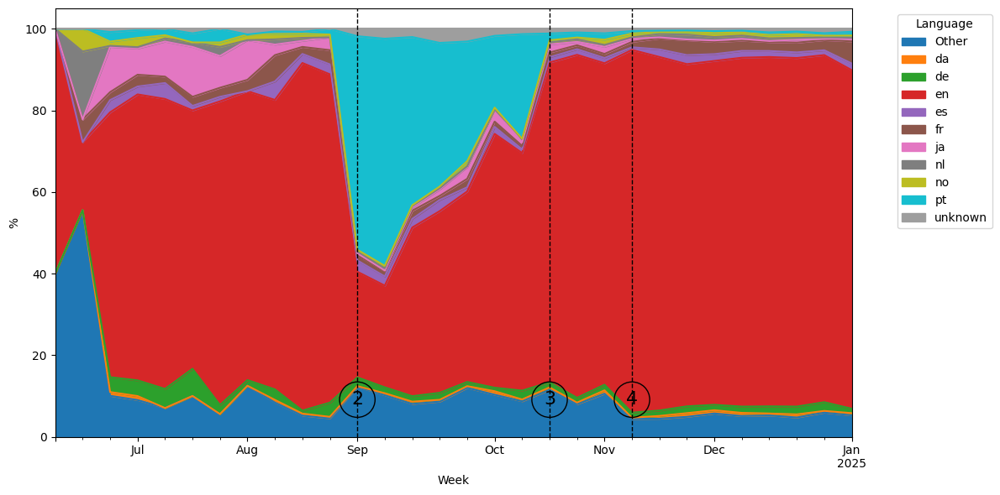

Total Languages: 51


In [5]:
important_dates = {
    "Twitter ban in Brazil (2)": "2024-08-30",
    "Twitter change to block visibility (3)": "2024-10-17",
    "US elections (4)": "2024-11-05",
}

original_colors = [
    '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', 
    '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf', 
    '#9e9e9e'  # New color added here
]

important_dates = {label: pd.to_datetime(date) for label, date in important_dates.items()}

plt.figure(figsize=(12, 6))
percentages_over_time.plot(
    kind='area',
    stacked=True,
    figsize=(12, 6),
    color=original_colors
)

for label, date in important_dates.items():
    plt.axvline(x=date, color='black', linestyle='--', linewidth=1, alpha=1)
    plt.annotate(
        text=label.split(" ")[-1].strip("()"),  # Extract the number from the label
        xy=(date, 5),  # Position the annotation near the x-axis
        xytext=(0, 10),  # Offset the text slightly above the line
        textcoords='offset points',
        ha='center',
        fontsize=16,
        color='black',
        bbox=dict(  # Add a circular background
            boxstyle='circle',
            facecolor='none',
            edgecolor='black',
            pad=0.5
        )
    )


# Customize labels, title, and layout
plt.xlabel('Week')
plt.ylabel('%')
plt.legend(title='Language', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

print(f"Total Languages: {total_languages}")

Unique labels found in the data:
['sexual' 'porn' 'graphic-media' 'nudity' 'corpse' 'gore'
 'sexual-figurative' 'threat' 'underwear' '!warn' 'self-harm' 'spoiler'
 'rude' '66885' 'graysky.app' 'extremist' 'Silly' 'Silly Cat' 'spam'
 '66901' 'icon-intolerant' 'misinformation' 'USPol' 'astronomy' '!hide'
 '66913' '66917' 'intolerant']


/tmp/ipykernel_3753229/1662289082.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['label_group'] = df_filtered['most_common_label'].apply(


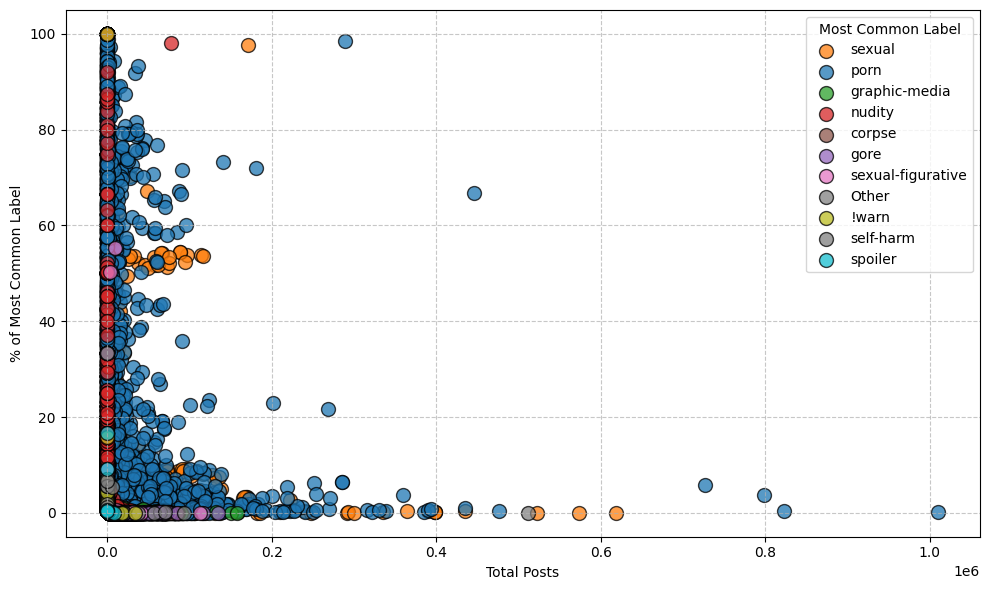

In [10]:
import pandas as pd
import matplotlib.pyplot as plt

file_path = "../feed_generators_processor_db/results.csv" 
df = pd.read_csv(file_path)

df_filtered = df[df['most_common_label'].notna() & (df['most_common_label'] != "")]

top_labels = df_filtered['most_common_label'].value_counts().nlargest(10).index

print("Unique labels found in the data:")
print(df_filtered['most_common_label'].unique())

df_filtered['label_group'] = df_filtered['most_common_label'].apply(
    lambda x: x if x in top_labels else "Other"
)

plt.figure(figsize=(10, 6))
unique_labels = df_filtered['label_group'].unique()
colors = plt.cm.tab10(range(len(unique_labels) - 1))
color_map = {label: colors[i] for i, label in enumerate(top_labels)}
color_map["Other"] = "gray" 

for label in unique_labels:
    subset = df_filtered[df_filtered['label_group'] == label]
    plt.scatter(
        subset['total_posts'],
        subset['percentage'],
        label=label,
        color=color_map[label],
        edgecolor='k',
        s=100,
        alpha=0.75
    )

# Add legend
plt.legend(title="Most Common Label", loc='upper right', fontsize=10)

plt.xlabel("Total Posts")
plt.ylabel("% of Most Common Label")

plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd

likes_data = pd.read_csv("../../output_and_test_data/starter_packs/feed_generator_likes.csv")
starter_pack_data = pd.read_csv("../../output_and_test_data/starter_packs/starter_pack_users.csv")

starter_pack_data['participants'] = starter_pack_data['participants'].str.split(';')

likes_data['src_prefix'] = likes_data['src'].str.split(':').str[1]

starter_pack_feed_generator_counts = {}

for index, row in starter_pack_data.iterrows():
    starter_pack_id = row['uri']
    participants = row['participants']
    
    if isinstance(participants, list):
        starter_pack_members = [p.split(':')[1] for p in participants if ':' in p]
        
        likes_filtered = likes_data[likes_data['src_prefix'].isin(starter_pack_members)]
        
        feed_generator_counts = likes_filtered.groupby('dst_collection')['src_prefix'].count()
        
        starter_pack_feed_generator_counts[starter_pack_id] = feed_generator_counts

results_df = pd.DataFrame.from_dict(starter_pack_feed_generator_counts, orient='index').fillna(0)
results_df.to_csv("../../output_and_test_data/starter_packs/starter_pack_feed_generator_counts_tes.csv")

print("Starter Pack Feed Generator Counts:")
print(results_df)

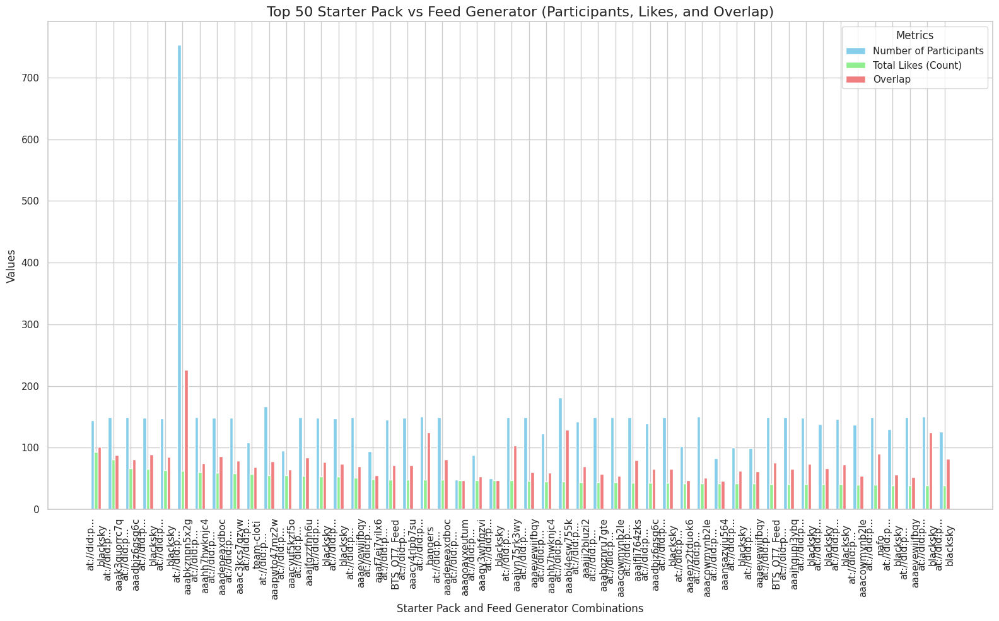

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

results_file = "../data/starter_packs/starter_pack_feed_generator_counts.csv"
data = pd.read_csv(results_file)

sns.set(style="whitegrid")

def calculate_values(data):
    grouped_data = data.groupby(['starter_pack_id', 'feed_generator']).agg(
        num_participants=('num_participants', 'sum'),  
        total_likes=('count', 'sum'),                   
        overlap=('overlap', 'max')                     
    ).reset_index()

    return grouped_data

processed_data = calculate_values(data)

top_50_data = processed_data.nlargest(50, 'total_likes')  

def plot_side_by_side_bars(processed_data):
    # Set up a figure for the plot
    fig, ax = plt.subplots(figsize=(16, 10))
    
    bar_width = 0.2
    index = range(len(processed_data))

    ax.bar(index, processed_data['num_participants'], bar_width, label='Number of Participants', color='skyblue')
    ax.bar([i + bar_width for i in index], processed_data['total_likes'], bar_width, label='Total Likes (Count)', color='lightgreen')
    ax.bar([i + 2 * bar_width for i in index], processed_data['overlap'], bar_width, label='Overlap', color='lightcoral')

    ax.set_title("Top 50 Starter Pack vs Feed Generator (Participants, Likes, and Overlap)", fontsize=16)
    ax.set_xlabel("Starter Pack and Feed Generator Combinations", fontsize=12)
    ax.set_ylabel("Values", fontsize=12)
    ax.set_xticks([i + bar_width for i in index]) 
    ax.set_xticklabels([f"{row['starter_pack_id'][:10]}...\n{row['feed_generator']}" for _, row in processed_data.iterrows()], rotation=90, ha="center")
    ax.legend(title="Metrics")
    
    plt.tight_layout()
    plt.show()

plot_side_by_side_bars(top_50_data)

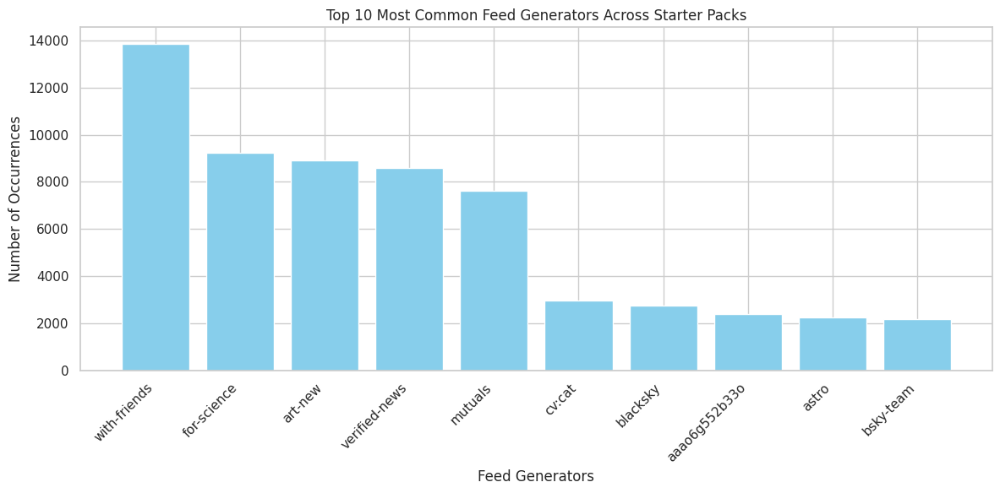

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter

file_path = '../data/starter_packs/starter_pack_feeds.csv'  
df = pd.read_csv(file_path)

all_feeds = []
for feeds in df['feeds'].dropna():
    all_feeds.extend(feeds.split(';'))

feed_counts = Counter(all_feeds)

top_feeds = feed_counts.most_common(10)

complete_feeds, counts = zip(*top_feeds)
display_names = [feed.split('/')[-1] for feed in complete_feeds]  # Extract last part for display

plt.figure(figsize=(12, 6))
plt.bar(display_names, counts, color='skyblue')
plt.ylabel('Number of Occurrences')
plt.xlabel('Feed Generators')
plt.title('Top 10 Most Common Feed Generators Across Starter Packs')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()




/tmp/ipykernel_367721/1846532434.py:85: UserWarning: Glyph 128204 (\N{PUSHPIN}) missing from current font.
  fig.tight_layout()
/tmp/ipykernel_367721/1846532434.py:85: UserWarning: Glyph 128240 (\N{NEWSPAPER}) missing from current font.
  fig.tight_layout()
/tmp/ipykernel_367721/1846532434.py:85: UserWarning: Glyph 128153 (\N{BLUE HEART}) missing from current font.
  fig.tight_layout()
/tmp/ipykernel_367721/1846532434.py:85: UserWarning: Glyph 128218 (\N{BOOKS}) missing from current font.
  fig.tight_layout()
/home/addr777/.local/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 128204 (\N{PUSHPIN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/addr777/.local/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 128240 (\N{NEWSPAPER}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/home/addr777/.local/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 

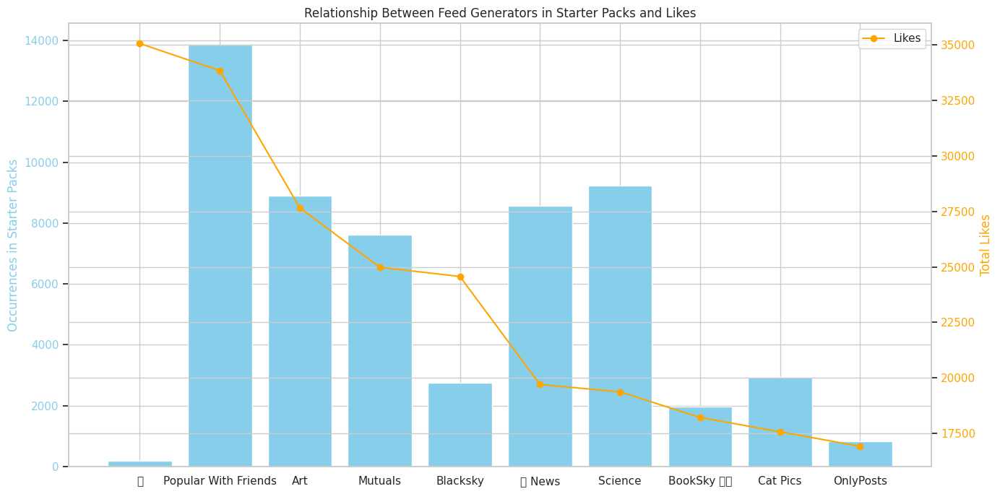

In [5]:
import pandas as pd
import os
import json
from collections import defaultdict, Counter
import matplotlib.pyplot as plt
from datetime import datetime

file_path = '../data/starter_packs/starter_pack_feeds.csv'
df = pd.read_csv(file_path)

all_feeds = []
for feeds in df['feeds'].dropna():
    all_feeds.extend(feeds.split(';'))

feed_counts = Counter(all_feeds)

feed_count_df = pd.DataFrame(feed_counts.items(), columns=['uri', 'count'])

directory = "../../feed_generators/output_and_test_data/feed_generators/downloaded_metadata_new"
specific_date = datetime(2024, 12, 24)
date_str = specific_date.strftime("%Y-%m-%d")
day_directory = os.path.join(directory, date_str)

likes_by_feed_generator = defaultdict(lambda: {"likes": 0, "display_name": ""})

if os.path.isdir(day_directory):
    for user_folder in os.listdir(day_directory):
        user_folder_path = os.path.join(day_directory, user_folder)
        if os.path.isdir(user_folder_path):
            for json_file in os.listdir(user_folder_path):
                if json_file.endswith('.json'):
                    json_file_path = os.path.join(user_folder_path, json_file)
                    try:
                        with open(json_file_path, "r") as f:
                            try:
                                data = json.load(f)
                                like_count = data["view"]["likeCount"]
                                display_name = data["view"].get("displayName", None)
                                uri = data["view"].get("uri", None)
                                
                                if uri:
                                    likes_by_feed_generator[uri]["likes"] += like_count
                                    likes_by_feed_generator[uri]["display_name"] = (
                                        display_name if display_name else uri.split('/')[-1]
                                    )
                            except json.JSONDecodeError:
                                print(f"Error decoding JSON in file: {json_file_path}")
                    except OSError as e:
                        print(f"Error opening file: {json_file_path}, {e}")

likes_df = pd.DataFrame([
    {'uri': uri, 'likes': data['likes'], 'display_name': data['display_name']}
    for uri, data in likes_by_feed_generator.items()
])

# Merge the two datasets based on 'uri'
merged_df = pd.merge(feed_count_df, likes_df, on='uri', how='inner')

# Sort by likes
merged_df = merged_df.sort_values(by='likes', ascending=False).head(10)

# Prepare data for plotting
display_names = merged_df['display_name']
occurrences = merged_df['count']
likes = merged_df['likes']

# Plot the results
fig, ax1 = plt.subplots(figsize=(14, 7))

# Plot occurrences
ax1.bar(display_names, occurrences, color='skyblue', label='Occurrences')
# ax1.set_xlabel('Feed Generator Display Name')
ax1.set_ylabel('Occurrences in Starter Packs', color='skyblue')
ax1.tick_params(axis='y', labelcolor='skyblue')

# Plot likes
ax2 = ax1.twinx()
ax2.plot(display_names, likes, color='orange', marker='o', label='Likes')
ax2.set_ylabel('Total Likes', color='orange')
ax2.tick_params(axis='y', labelcolor='orange')

# Add title and layout
plt.title(f'Relationship Between Feed Generators in Starter Packs and Likes')
plt.xticks(rotation=45, ha='right')
fig.tight_layout()
plt.legend()
plt.show()


The most common feed URI is: at://did:plc:z72i7hdynmk6r22z27h6tvur/app.bsky.feed.generator/with-friends
Inclusion date for the most common feed: 2024-12-14 00:01:16.635000


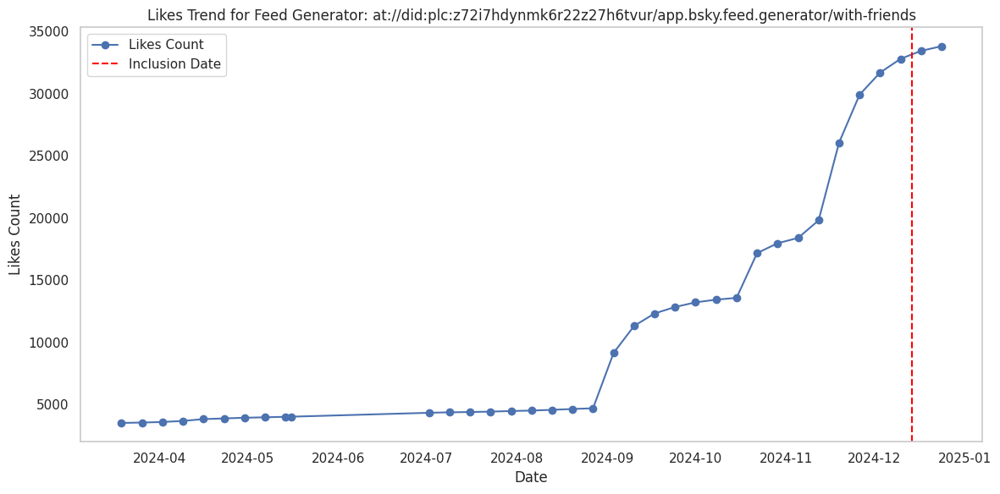

In [7]:
import os
import json
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt
from datetime import datetime

starter_packs_path = '../data/starter_packs/starterpacks_newer.csv'
starter_pack_feeds_path = '../data/starter_packs/starter_pack_feeds.csv'
metadata_dir =  "../../feed_generators/output_and_test_data/feed_generators/downloaded_metadata_new"

starter_packs = pd.read_csv(starter_packs_path)
starter_pack_feeds = pd.read_csv(starter_pack_feeds_path)

starter_packs_subset = starter_packs  

selected_uris = starter_packs_subset['uri']
feeds_to_process = starter_pack_feeds[starter_pack_feeds['uri'].isin(selected_uris)]

feeds_to_inclusion_date = {}
for _, row in feeds_to_process.iterrows():
    feeds = str(row['feeds']).split(';') if pd.notna(row['feeds']) else []
    inclusion_date = pd.to_datetime(
        starter_packs_subset.loc[starter_packs_subset['uri'] == row['uri'], 'createdAt'].values[0]
    ).tz_localize(None)  # Remove timezone information
    for feed in feeds:
        feeds_to_inclusion_date[feed] = inclusion_date

likes_history = defaultdict(lambda: defaultdict(int))  # uri -> date -> likes

for date_folder in os.listdir(metadata_dir):
    date_path = os.path.join(metadata_dir, date_folder)
    if os.path.isdir(date_path):
        for user_folder in os.listdir(date_path):
            user_folder_path = os.path.join(date_path, user_folder)
            if os.path.isdir(user_folder_path):
                for json_file in os.listdir(user_folder_path):
                    if json_file.endswith('.json'):
                        json_file_path = os.path.join(user_folder_path, json_file)
                        try:
                            with open(json_file_path, "r") as f:
                                data = json.load(f)
                                like_count = data["view"]["likeCount"]
                                uri = data["view"].get("uri", None)
                                if uri in feeds_to_inclusion_date: 
                                    likes_history[uri][date_folder] += like_count
                        except Exception as e:
                            print(f"Error processing file: {json_file_path}, {e}")

likes_history_flat = []
for uri, dates in likes_history.items():
    for date, likes in dates.items():
        inclusion_date = feeds_to_inclusion_date.get(uri, None)
        likes_history_flat.append({
            'uri': uri,
            'date': pd.to_datetime(date).tz_localize(None),  # Remove timezone information
            'likes': likes,
            'inclusion_date': inclusion_date,
            'period': (
                'Before Inclusion'
                if inclusion_date and pd.to_datetime(date).tz_localize(None) < inclusion_date
                else 'After Inclusion'
            )
        })

likes_history_df = pd.DataFrame(likes_history_flat)

most_common_feed = feeds_to_process['feeds'].str.split(';').explode().mode().values[0]
print(f"The most common feed URI is: {most_common_feed}")

if most_common_feed in feeds_to_inclusion_date:
    inclusion_date = feeds_to_inclusion_date[most_common_feed]
    print(f"Inclusion date for the most common feed: {inclusion_date}")
else:
    raise ValueError(f"{most_common_feed} is not found in the inclusion date mapping.")

selected_data = likes_history_df[likes_history_df['uri'] == most_common_feed].sort_values('date')

plt.figure(figsize=(12, 6))
plt.plot(selected_data['date'], selected_data['likes'], marker='o', label='Likes Count')

if inclusion_date:
    plt.axvline(inclusion_date, color='red', linestyle='--', label='Inclusion Date')

plt.title(f"Likes Trend for Feed Generator: {most_common_feed}")
plt.xlabel("Date")
plt.ylabel("Likes Count")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()


The most common feed URI is: at://did:plc:z72i7hdynmk6r22z27h6tvur/app.bsky.feed.generator/with-friends
Inclusion date for the most common feed: 2024-12-14 00:01:16.635000


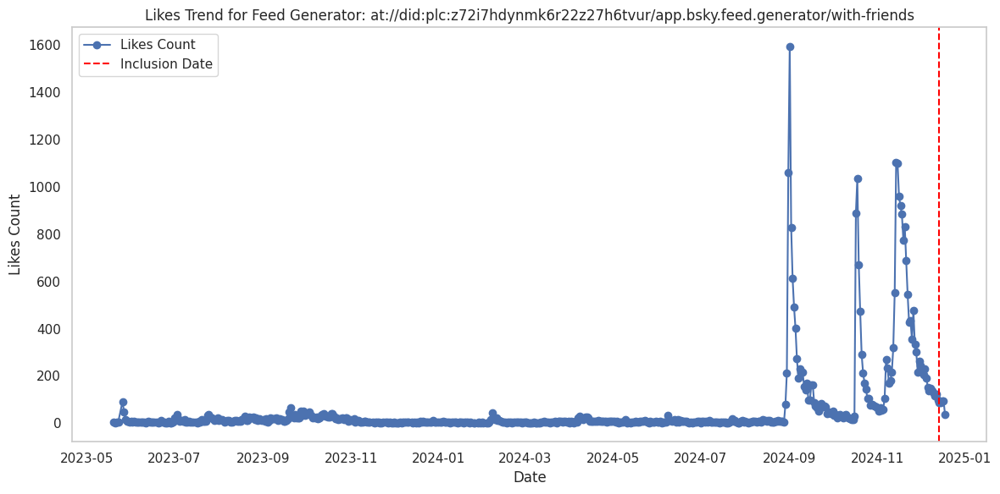

In [9]:
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt

# File paths
starter_packs_path = '../data/starter_packs/starterpacks_newer.csv'
starter_pack_feeds_path = '../data/starter_packs/starter_pack_feeds.csv'
likes_file_path = "../../feed_generators/output_and_test_data/feed_generators/feed_generator_likes.csv"


starter_packs = pd.read_csv(starter_packs_path)
starter_pack_feeds = pd.read_csv(starter_pack_feeds_path)
likes_data = pd.read_csv(likes_file_path, header=None)

likes_data.columns = ['src', 'dst_did', 'dst_collection', 'dst_rkey', 'created_at']

likes_data = likes_data[likes_data['created_at'] != 'created_at']  # Remove header rows
likes_data['created_at'] = pd.to_datetime(likes_data['created_at'], errors='coerce', format='%Y-%m-%dT%H:%M:%S.%fZ')
likes_data = likes_data.dropna(subset=['created_at'])  # Remove invalid timestamps
likes_data['date'] = likes_data['created_at'].dt.date

likes_data['uri'] = 'at://' + likes_data['dst_did'] + '/' + likes_data['dst_collection'] + '/' + likes_data['dst_rkey']

starter_packs_subset = starter_packs  # No limit on starter packs
selected_uris = starter_packs_subset['uri']
feeds_to_process = starter_pack_feeds[starter_pack_feeds['uri'].isin(selected_uris)]

feeds_to_inclusion_date = {}
for _, row in feeds_to_process.iterrows():
    feeds = str(row['feeds']).split(';') if pd.notna(row['feeds']) else []
    inclusion_date = pd.to_datetime(
        starter_packs_subset.loc[starter_packs_subset['uri'] == row['uri'], 'createdAt'].values[0]
    ).tz_localize(None)  # Remove timezone information
    for feed in feeds:
        feeds_to_inclusion_date[feed] = inclusion_date

likes_history = defaultdict(lambda: defaultdict(int))  # uri -> date -> likes
for _, row in likes_data.iterrows():
    uri = row['uri']
    if uri in feeds_to_inclusion_date:
        likes_history[uri][row['date']] += 1

likes_history_flat = []
for uri, dates in likes_history.items():
    for date, likes in dates.items():
        inclusion_date = feeds_to_inclusion_date.get(uri, None)
        likes_history_flat.append({
            'uri': uri,
            'date': pd.to_datetime(date).tz_localize(None),  # Remove timezone information
            'likes': likes,
            'inclusion_date': inclusion_date,
            'period': (
                'Before Inclusion'
                if inclusion_date and pd.to_datetime(date).tz_localize(None) < inclusion_date
                else 'After Inclusion'
            )
        })

likes_history_df = pd.DataFrame(likes_history_flat)

most_common_feed = feeds_to_process['feeds'].str.split(';').explode().mode().values[0]
print(f"The most common feed URI is: {most_common_feed}")

if most_common_feed in feeds_to_inclusion_date:
    inclusion_date = feeds_to_inclusion_date[most_common_feed]
    print(f"Inclusion date for the most common feed: {inclusion_date}")
else:
    raise ValueError(f"{most_common_feed} is not found in the inclusion date mapping.")

selected_data = likes_history_df[likes_history_df['uri'] == most_common_feed].sort_values('date')

plt.figure(figsize=(12, 6))
plt.plot(selected_data['date'], selected_data['likes'], marker='o', label='Likes Count')

if inclusion_date:
    plt.axvline(inclusion_date, color='red', linestyle='--', label='Inclusion Date')

plt.title(f"Likes Trend for Feed Generator: {most_common_feed}")
plt.xlabel("Date")
plt.ylabel("Likes Count")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

In [10]:
# Step 8.1: Calculate the number of starter packs the most common feed is included in
feed_starter_pack_count = feeds_to_process['feeds'].str.contains(most_common_feed, na=False).sum()
print(f"The most common feed URI ({most_common_feed}) is included in {feed_starter_pack_count} starter packs.")


The most common feed URI (at://did:plc:z72i7hdynmk6r22z27h6tvur/app.bsky.feed.generator/with-friends) is included in 13580 starter packs.


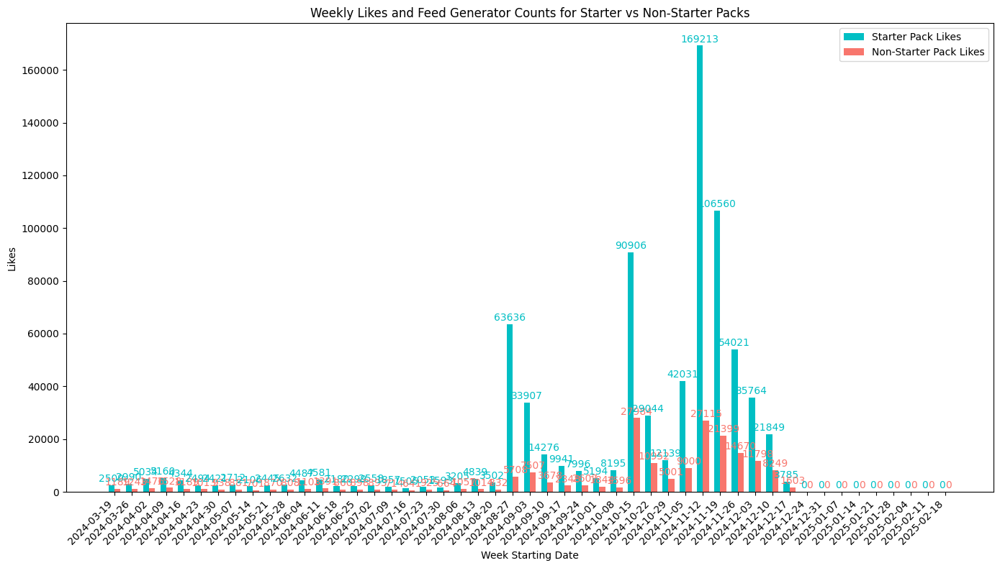

In [ ]:
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt
from datetime import datetime, timedelta

feed_generator_info_path = "../../output_and_test_data/starter_packs/feed_generator_info.csv"
likes_file_path = "../../output_and_test_data/starter_packs/feed_generator_likes.csv"

feed_generator_info = pd.read_csv(feed_generator_info_path)
feed_generator_info['uri'] = feed_generator_info['uri'].str.strip()  # Clean URI strings
starter_pack_uris = set(feed_generator_info['uri'])

likes_data = pd.read_csv(likes_file_path, header=None)
likes_data.columns = ['src', 'dst_did', 'dst_collection', 'dst_rkey', 'created_at']
likes_data = likes_data[likes_data['created_at'] != 'created_at']  # Remove header rows
likes_data['created_at'] = pd.to_datetime(likes_data['created_at'], errors='coerce', format='%Y-%m-%dT%H:%M:%S.%fZ')
likes_data = likes_data.dropna(subset=['created_at'])  # Remove invalid timestamps
likes_data['date'] = likes_data['created_at'].dt.date

likes_data['uri'] = 'at://' + likes_data['dst_did'] + '/' + likes_data['dst_collection'] + '/' + likes_data['dst_rkey']

first_like_dates = likes_data.groupby('uri')['date'].min().to_dict()

creation_dates = {uri: first_like_dates.get(uri, None) for uri in starter_pack_uris}

likes_by_week_starter = defaultdict(int)
likes_by_week_non_starter = defaultdict(int)
json_files_by_week_starter = defaultdict(int)
json_files_by_week_non_starter = defaultdict(int)

start_date = datetime(2024, 3, 19)
current_date = datetime.now().date()

while start_date.date() <= current_date:
    week_start = start_date.date()
    week_end = (start_date + timedelta(days=6)).date()
    weekly_data = likes_data[(likes_data['date'] >= week_start) & (likes_data['date'] <= week_end)]
    
    starter_likes, non_starter_likes = 0, 0
    starter_files, non_starter_files = 0, 0

    for _, row in weekly_data.iterrows():
        uri = row['uri']
        if uri in starter_pack_uris:
            starter_likes += 1
            starter_files += 1
        else:
            non_starter_likes += 1
            non_starter_files += 1
    
    likes_by_week_starter[week_start.strftime("%Y-%m-%d")] = starter_likes
    likes_by_week_non_starter[week_start.strftime("%Y-%m-%d")] = non_starter_likes
    json_files_by_week_starter[week_start.strftime("%Y-%m-%d")] = starter_files
    json_files_by_week_non_starter[week_start.strftime("%Y-%m-%d")] = non_starter_files
    
    start_date += timedelta(days=7)

sorted_weeks = sorted(likes_by_week_starter.keys())
weeks = [week for week in sorted_weeks]

starter_likes = [likes_by_week_starter[week] for week in sorted_weeks]
non_starter_likes = [likes_by_week_non_starter[week] for week in sorted_weeks]
starter_counts = [json_files_by_week_starter[week] for week in sorted_weeks]
non_starter_counts = [json_files_by_week_non_starter[week] for week in sorted_weeks]

bar_width = 0.35 
x = range(len(weeks))  # X positions for the bar groups

plt.figure(figsize=(14, 8))

starter_bars = plt.bar(
    [i - bar_width / 2 for i in x],
    starter_likes,
    width=bar_width,
    color='#00BFC4',
    label='Starter Pack Likes'
)

non_starter_bars = plt.bar(
    [i + bar_width / 2 for i in x],
    non_starter_likes,
    width=bar_width,
    color='#F8766D',
    label='Non-Starter Pack Likes'
)

# Annotate counts on bars
for i, (starter_bar, non_starter_bar) in enumerate(zip(starter_bars, non_starter_bars)):
    # Starter pack annotation
    plt.text(
        starter_bar.get_x() + starter_bar.get_width() / 2,
        starter_bar.get_height() + 500,  # Adjust based on your data range
        f'{starter_counts[i]}',
        ha='center',
        va='bottom',
        fontsize=10,
        color='#00BFC4'
    )
    # Non-starter pack  annotation
    plt.text(
        non_starter_bar.get_x() + non_starter_bar.get_width() / 2,
        non_starter_bar.get_height() + 500, 
        f'{non_starter_counts[i]}',
        ha='center',
        va='bottom',
        fontsize=10,
        color='#F8766D'
    )

# Formatting
plt.xlabel('Week Starting Date')
plt.ylabel('Likes')
plt.title('Weekly Likes and Feed Generator Counts for Starter vs Non-Starter Packs')
plt.xticks(ticks=x, labels=weeks, rotation=45, ha='right')
plt.legend()

plt.tight_layout()
plt.show()

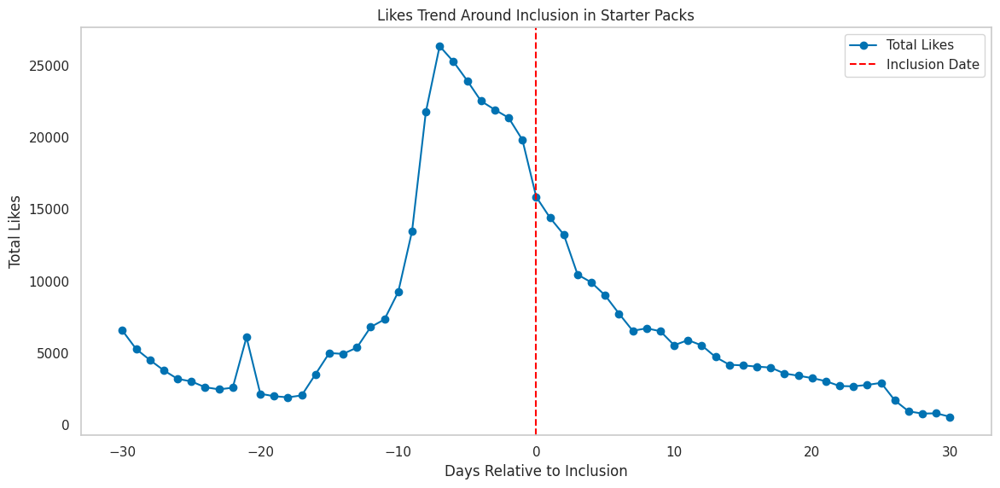

In [23]:
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt

starter_packs_path = "../../output_and_test_data/starter_packs/starterpacks.csv"
starter_pack_feeds_path = "../../output_and_test_data/starter_packs/starter_pack_feeds.csv"
likes_file_path = "../../output_and_test_data/starter_packs/feed_generator_likes.csv"

starter_packs = pd.read_csv(starter_packs_path)
starter_pack_feeds = pd.read_csv(starter_pack_feeds_path)
likes_data = pd.read_csv(likes_file_path, header=None)

likes_data.columns = ['src', 'dst_did', 'dst_collection', 'dst_rkey', 'created_at']

likes_data = likes_data[likes_data['created_at'] != 'created_at']  # Remove header rows
likes_data['created_at'] = pd.to_datetime(likes_data['created_at'], errors='coerce', format='%Y-%m-%dT%H:%M:%S.%fZ')
likes_data = likes_data.dropna(subset=['created_at'])  # Remove invalid timestamps
likes_data['date'] = likes_data['created_at'].dt.date

likes_data['uri'] = 'at://' + likes_data['dst_did'] + '/' + likes_data['dst_collection'] + '/' + likes_data['dst_rkey']

feeds_to_inclusion_date = {}
for _, row in starter_pack_feeds.iterrows():
    feeds = str(row['feeds']).split(';') if pd.notna(row['feeds']) else []
    matching_rows = starter_packs.loc[starter_packs['uri'] == row['uri']]
    if matching_rows.empty:
        print(f"Warning: No matching 'uri' found for {row['uri']}")
        continue  # Skip this row if no match is found
    inclusion_date = pd.to_datetime(matching_rows['createdAt'].values[0]).tz_localize(None)
    for feed in feeds:
        feeds_to_inclusion_date[feed] = inclusion_date

likes_history = defaultdict(lambda: defaultdict(int))  # uri -> date -> likes
for _, row in likes_data.iterrows():
    uri = row['uri']
    if uri in feeds_to_inclusion_date:
        likes_history[uri][row['date']] += 1

relative_likes = defaultdict(int)  # day_offset -> total_likes
for uri, inclusion_date in feeds_to_inclusion_date.items():
    for date, likes in likes_history[uri].items():
        date = pd.to_datetime(date).tz_localize(None)
        day_offset = (date - inclusion_date).days
        if -30 <= day_offset <= 30:  # Only consider 30 days before and after inclusion date
            relative_likes[day_offset] += likes

relative_likes_df = pd.DataFrame.from_dict(relative_likes, orient='index', columns=['likes'])
relative_likes_df.index.name = 'day_offset'
relative_likes_df.reset_index(inplace=True)
relative_likes_df = relative_likes_df.sort_values('day_offset')

plt.figure(figsize=(12, 6))
plt.plot(relative_likes_df['day_offset'], relative_likes_df['likes'], marker='o', label='Total Likes')

plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')

plt.title("Likes Trend Around Inclusion in Starter Packs")
plt.xlabel("Days Relative to Inclusion")
plt.ylabel("Total Likes")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd

starter_pack_feeds_path = "../../output_and_test_data/starter_packs/starter_packs/starter_pack_feeds.csv"

starter_pack_feeds = pd.read_csv(starter_pack_feeds_path)

starter_pack_feeds['feeds'] = starter_pack_feeds['feeds'].fillna('')  # Replace NaN with empty string

starter_packs_with_at_least_one_feed = starter_pack_feeds[starter_pack_feeds['feeds'].str.contains('feed.generator', na=False)]

starter_packs_without_feeds = starter_pack_feeds[~starter_pack_feeds['feeds'].str.contains('feed.generator', na=False)]

# Print first 10 of each category
# print("First 10 starter packs with at least one feed generator:")
# print(starter_packs_with_at_least_one_feed.head(10))

# print("\nFirst 10 starter packs without any feed generators:")
# print(starter_packs_without_feeds.head(10))

num_starter_packs_with_at_least_one_feed = len(starter_packs_with_at_least_one_feed)
num_starter_packs_without_feeds = len(starter_packs_without_feeds)

print(f"\nTotal starter packs: {len(starter_pack_feeds)}")
print(f"Starter packs with at least one feed generator: {num_starter_packs_with_at_least_one_feed}")
print(f"Starter packs without any feed generators: {num_starter_packs_without_feeds}")

First 10 starter packs with at least one feed generator:
                                                  uri  \
0   at://did:plc:oisofpd7lj26yvgiivf3lxsi/app.bsky...   
1   at://did:plc:oisofpd7lj26yvgiivf3lxsi/app.bsky...   
3   at://did:plc:oisofpd7lj26yvgiivf3lxsi/app.bsky...   
7   at://did:plc:vjug55kidv6sye7ykr5faxxn/app.bsky...   
8   at://did:plc:vjug55kidv6sye7ykr5faxxn/app.bsky...   
10  at://did:plc:7opjnfmb6gtbgjrsr3777ujx/app.bsky...   
11  at://did:plc:ge3kbmqsuxiph4wyrbgyzkpi/app.bsky...   
12  at://did:plc:wznqcj33rsqriyff2b3xw3mp/app.bsky...   
13  at://did:plc:7opjnfmb6gtbgjrsr3777ujx/app.bsky...   
15  at://did:plc:7opjnfmb6gtbgjrsr3777ujx/app.bsky...   

                                                feeds  \
0   at://did:plc:q6gjnaw2blty4crticxkmujt/app.bsky...   
1   at://did:plc:kkf4naxqmweop7dv4l2iqqf5/app.bsky...   
3   at://did:plc:z72i7hdynmk6r22z27h6tvur/app.bsky...   
7   at://did:plc:vpkhqolt662uhesyj6nxm7ys/app.bsky...   
8   at://did:plc:vpkhqolt662uh

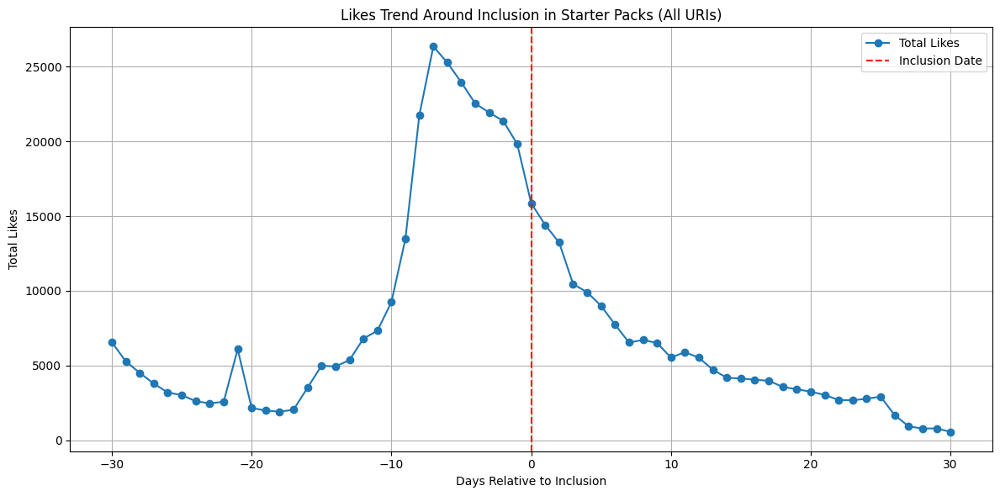

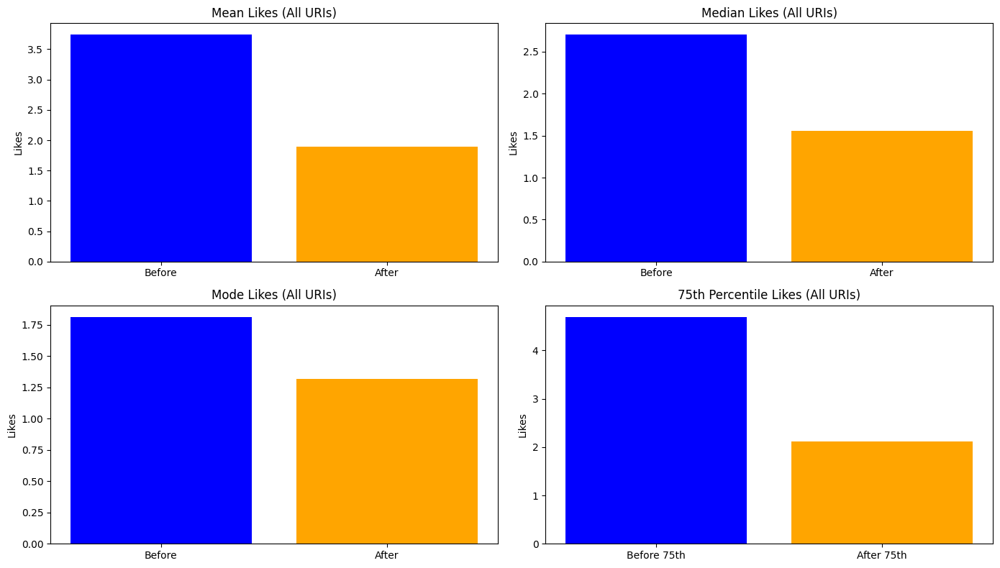

In [1]:
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt
import numpy as np

# File paths
starter_packs_path = "../../output_and_test_data/starter_packs/starter_packs/starterpacks.csv"
starter_pack_feeds_path = "../../output_and_test_data/starter_packs/starter_packs/starter_packs/starter_pack_feeds.csv"
likes_file_path = "../../output_and_test_data/starter_packs/starter_packs/starter_packs/feed_generator_likes.csv"

# Load data
starter_packs = pd.read_csv(starter_packs_path)
starter_pack_feeds = pd.read_csv(starter_pack_feeds_path)
likes_data = pd.read_csv(likes_file_path, header=None)

# Assign column names for likes data
likes_data.columns = ['src', 'dst_did', 'dst_collection', 'dst_rkey', 'created_at']

# Clean and process likes data
likes_data = likes_data[likes_data['created_at'] != 'created_at']  # Remove header rows
likes_data['created_at'] = pd.to_datetime(likes_data['created_at'], errors='coerce', format='%Y-%m-%dT%H:%M:%S.%fZ')
likes_data = likes_data.dropna(subset=['created_at'])  # Remove invalid timestamps
likes_data['date'] = likes_data['created_at'].dt.date

# Construct the URI from dst_did, dst_collection, and dst_rkey
likes_data['uri'] = 'at://' + likes_data['dst_did'] + '/' + likes_data['dst_collection'] + '/' + likes_data['dst_rkey']

# Map feeds to their inclusion dates
feeds_to_inclusion_date = {}
for _, row in starter_pack_feeds.iterrows():
    feeds = str(row['feeds']).split(';') if pd.notna(row['feeds']) else []
    matching_rows = starter_packs.loc[starter_packs['uri'] == row['uri']]
    if matching_rows.empty:
        print(f"Warning: No matching 'uri' found for {row['uri']}")
        continue  # Skip this row if no match is found
    inclusion_date = pd.to_datetime(matching_rows['createdAt'].values[0]).tz_localize(None)
    for feed in feeds:
        feeds_to_inclusion_date[feed] = inclusion_date

# Aggregate likes data based on URIs
likes_history = defaultdict(lambda: defaultdict(int))  # uri -> date -> likes
for _, row in likes_data.iterrows():
    uri = row['uri']
    if uri in feeds_to_inclusion_date:
        likes_history[uri][row['date']] += 1

# Calculate relative likes around the inclusion date
relative_likes = defaultdict(int)  # day_offset -> total_likes
for uri, inclusion_date in feeds_to_inclusion_date.items():
    for date, likes in likes_history[uri].items():
        date = pd.to_datetime(date).tz_localize(None)
        day_offset = (date - inclusion_date).days
        if -30 <= day_offset <= 30:  # Only consider 30 days before and after inclusion date
            relative_likes[day_offset] += likes

# Prepare the DataFrame for plotting
relative_likes_df = pd.DataFrame.from_dict(relative_likes, orient='index', columns=['likes'])
relative_likes_df.index.name = 'day_offset'
relative_likes_df.reset_index(inplace=True)
relative_likes_df = relative_likes_df.sort_values('day_offset')

# Plot the total likes trend (for all URIs)
plt.figure(figsize=(12, 6))
plt.plot(relative_likes_df['day_offset'], relative_likes_df['likes'], marker='o', label='Total Likes')

# Mark the inclusion date with a red line
plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')

# Add titles and labels
plt.title("Likes Trend Around Inclusion in Starter Packs (All URIs)")
plt.xlabel("Days Relative to Inclusion")
plt.ylabel("Total Likes")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

# Calculate basic statistics for all URIs
def calculate_basic_stats(likes_history, feeds_to_inclusion_date):
    stats = []
    for uri, inclusion_date in feeds_to_inclusion_date.items():
        likes_before = []
        likes_after = []
        for date, likes in likes_history[uri].items():
            date = pd.to_datetime(date).tz_localize(None)
            day_offset = (date - inclusion_date).days
            if -30 <= day_offset < 0:  # 30 days before inclusion
                likes_before.append(likes)
            elif 0 < day_offset <= 30:  # 30 days after inclusion
                likes_after.append(likes)
        
        # Calculate statistics for likes before inclusion
        if likes_before:
            stats_before = {
                'uri': uri,
                'period': 'before',
                'mean': np.mean(likes_before),
                'median': np.median(likes_before),
                'mode': pd.Series(likes_before).mode().iloc[0] if not pd.Series(likes_before).mode().empty else None,
                '75th_percentile': np.percentile(likes_before, 75),
                '50th_percentile': np.percentile(likes_before, 50),
            }
            stats.append(stats_before)
        
        # Calculate statistics for likes after inclusion
        if likes_after:
            stats_after = {
                'uri': uri,
                'period': 'after',
                'mean': np.mean(likes_after),
                'median': np.median(likes_after),
                'mode': pd.Series(likes_after).mode().iloc[0] if not pd.Series(likes_after).mode().empty else None,
                '75th_percentile': np.percentile(likes_after, 75),
                '50th_percentile': np.percentile(likes_after, 50),
            }
            stats.append(stats_after)
    
    return pd.DataFrame(stats)

# Calculate statistics for all URIs
stats_df = calculate_basic_stats(likes_history, feeds_to_inclusion_date)

# Plot additional statistics (for all URIs)
def plot_statistics(stats_df):
    # Group statistics by period (before/after)
    stats_before = stats_df[stats_df['period'] == 'before']
    stats_after = stats_df[stats_df['period'] == 'after']
    
    # Plot mean, median, and mode
    plt.figure(figsize=(14, 8))
    
    # Mean
    plt.subplot(2, 2, 1)
    plt.bar(['Before', 'After'], [stats_before['mean'].mean(), stats_after['mean'].mean()], color=['blue', 'orange'])
    plt.title('Mean Likes (All URIs)')
    plt.ylabel('Likes')
    
    # Median
    plt.subplot(2, 2, 2)
    plt.bar(['Before', 'After'], [stats_before['median'].mean(), stats_after['median'].mean()], color=['blue', 'orange'])
    plt.title('Median Likes (All URIs)')
    plt.ylabel('Likes')
    
    # Mode
    plt.subplot(2, 2, 3)
    plt.bar(['Before', 'After'], [stats_before['mode'].mean(), stats_after['mode'].mean()], color=['blue', 'orange'])
    plt.title('Mode Likes (All URIs)')
    plt.ylabel('Likes')
    
    # Percentiles
    plt.subplot(2, 2, 4)
    plt.bar(['Before 75th', 'After 75th'], [stats_before['75th_percentile'].mean(), stats_after['75th_percentile'].mean()], color=['blue', 'orange'])
    plt.title('75th Percentile Likes (All URIs)')
    plt.ylabel('Likes')
    
    plt.tight_layout()
    plt.show()

# Plot the additional statistics
plot_statistics(stats_df)

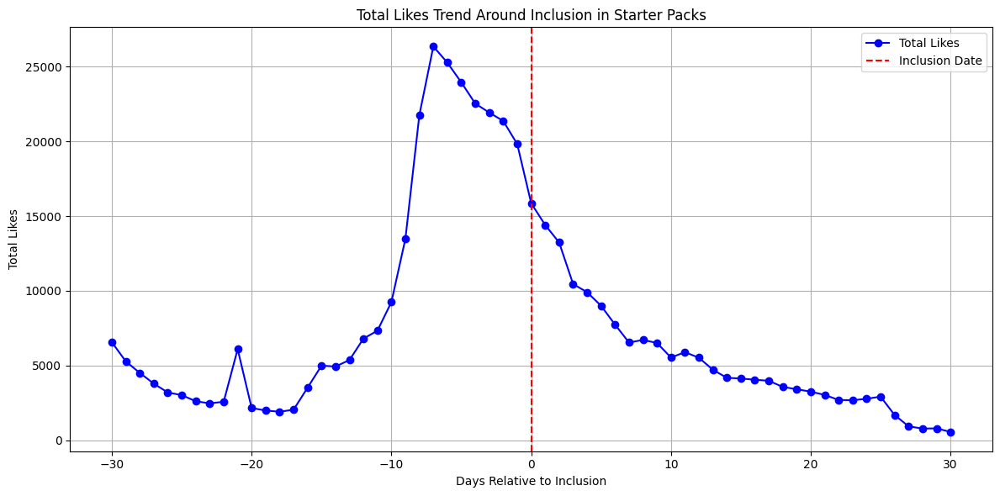

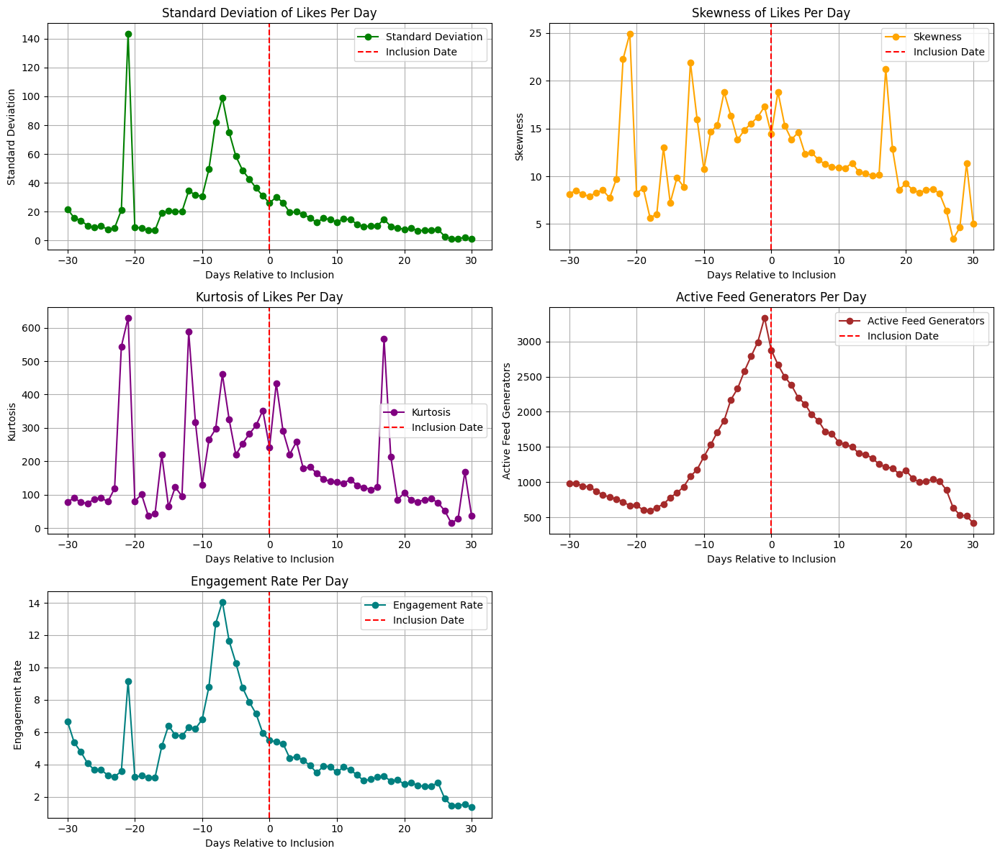

In [2]:
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import skew, kurtosis

# File paths
starter_packs_path = "../../output_and_test_data/starter_packs/starter_packs/starterpacks.csv"
starter_pack_feeds_path = "../../output_and_test_data/starter_packs/starter_packs/starter_pack_feeds.csv"
likes_file_path = "../../output_and_test_data/starter_packs/starter_packs/feed_generator_likes.csv"

# Load data
starter_packs = pd.read_csv(starter_packs_path)
starter_pack_feeds = pd.read_csv(starter_pack_feeds_path)
likes_data = pd.read_csv(likes_file_path, header=None)

# Assign column names for likes data
likes_data.columns = ['src', 'dst_did', 'dst_collection', 'dst_rkey', 'created_at']

# Clean and process likes data
likes_data = likes_data[likes_data['created_at'] != 'created_at']  # Remove header rows
likes_data['created_at'] = pd.to_datetime(likes_data['created_at'], errors='coerce', format='%Y-%m-%dT%H:%M:%S.%fZ')
likes_data = likes_data.dropna(subset=['created_at'])  # Remove invalid timestamps
likes_data['date'] = likes_data['created_at'].dt.date

# Construct the URI from dst_did, dst_collection, and dst_rkey
likes_data['uri'] = 'at://' + likes_data['dst_did'] + '/' + likes_data['dst_collection'] + '/' + likes_data['dst_rkey']

# Map feeds to their inclusion dates
feeds_to_inclusion_date = {}
for _, row in starter_pack_feeds.iterrows():
    feeds = str(row['feeds']).split(';') if pd.notna(row['feeds']) else []
    matching_rows = starter_packs.loc[starter_packs['uri'] == row['uri']]
    if matching_rows.empty:
        print(f"Warning: No matching 'uri' found for {row['uri']}")
        continue  # Skip this row if no match is found
    inclusion_date = pd.to_datetime(matching_rows['createdAt'].values[0]).tz_localize(None)
    for feed in feeds:
        feeds_to_inclusion_date[feed] = inclusion_date

# Aggregate likes data based on URIs
likes_history = defaultdict(lambda: defaultdict(int))  # uri -> date -> likes
for _, row in likes_data.iterrows():
    uri = row['uri']
    if uri in feeds_to_inclusion_date:
        likes_history[uri][row['date']] += 1

# Calculate relative likes around the inclusion date
relative_likes = defaultdict(list)  # day_offset -> list of likes
active_feed_generators = defaultdict(int)  # day_offset -> number of active feed generators
for uri, inclusion_date in feeds_to_inclusion_date.items():
    for date, likes in likes_history[uri].items():
        date = pd.to_datetime(date).tz_localize(None)
        day_offset = (date - inclusion_date).days
        if -30 <= day_offset <= 30:  # Only consider 30 days before and after inclusion date
            relative_likes[day_offset].append(likes)
            active_feed_generators[day_offset] += 1

# Prepare the DataFrame for plotting
daily_stats = []
for day_offset, likes_list in relative_likes.items():
    if likes_list:  # Only calculate stats if there are likes for this day
        daily_stats.append({
            'day_offset': day_offset,
            'mean': np.mean(likes_list),
            'median': np.median(likes_list),
            'mode': pd.Series(likes_list).mode().iloc[0] if not pd.Series(likes_list).mode().empty else None,
            '75th_percentile': np.percentile(likes_list, 75),
            '50th_percentile': np.percentile(likes_list, 50),
            'std_dev': np.std(likes_list),  # Standard deviation
            'skewness': skew(likes_list),  # Skewness
            'kurtosis': kurtosis(likes_list),  # Kurtosis
            'total_likes': sum(likes_list),
            'active_feed_generators': active_feed_generators[day_offset],
            'engagement_rate': sum(likes_list) / active_feed_generators[day_offset]  # Engagement rate
        })

daily_stats_df = pd.DataFrame(daily_stats)
daily_stats_df = daily_stats_df.sort_values('day_offset')

# Plot the total likes trend
plt.figure(figsize=(12, 6))
plt.plot(daily_stats_df['day_offset'], daily_stats_df['total_likes'], marker='o', label='Total Likes', color='blue')
plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')
plt.title("Total Likes Trend Around Inclusion in Starter Packs")
plt.xlabel("Days Relative to Inclusion")
plt.ylabel("Total Likes")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

# Plot additional metrics
def plot_additional_metrics(daily_stats_df):
    plt.figure(figsize=(14, 12))
    
    # Standard Deviation
    plt.subplot(3, 2, 1)
    plt.plot(daily_stats_df['day_offset'], daily_stats_df['std_dev'], marker='o', label='Standard Deviation', color='green')
    plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')
    plt.title('Standard Deviation of Likes Per Day')
    plt.xlabel("Days Relative to Inclusion")
    plt.ylabel("Standard Deviation")
    plt.legend()
    plt.grid()
    
    # Skewness
    plt.subplot(3, 2, 2)
    plt.plot(daily_stats_df['day_offset'], daily_stats_df['skewness'], marker='o', label='Skewness', color='orange')
    plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')
    plt.title('Skewness of Likes Per Day')
    plt.xlabel("Days Relative to Inclusion")
    plt.ylabel("Skewness")
    plt.legend()
    plt.grid()
    
    # Kurtosis
    plt.subplot(3, 2, 3)
    plt.plot(daily_stats_df['day_offset'], daily_stats_df['kurtosis'], marker='o', label='Kurtosis', color='purple')
    plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')
    plt.title('Kurtosis of Likes Per Day')
    plt.xlabel("Days Relative to Inclusion")
    plt.ylabel("Kurtosis")
    plt.legend()
    plt.grid()
    
    # Active Feed Generators
    plt.subplot(3, 2, 4)
    plt.plot(daily_stats_df['day_offset'], daily_stats_df['active_feed_generators'], marker='o', label='Active Feed Generators', color='brown')
    plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')
    plt.title('Active Feed Generators Per Day')
    plt.xlabel("Days Relative to Inclusion")
    plt.ylabel("Active Feed Generators")
    plt.legend()
    plt.grid()
    
    # Engagement Rate
    plt.subplot(3, 2, 5)
    plt.plot(daily_stats_df['day_offset'], daily_stats_df['engagement_rate'], marker='o', label='Engagement Rate', color='teal')
    plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')
    plt.title('Engagement Rate Per Day')
    plt.xlabel("Days Relative to Inclusion")
    plt.ylabel("Engagement Rate")
    plt.legend()
    plt.grid()
    
    plt.tight_layout()
    plt.show()

# Plot the additional metrics
plot_additional_metrics(daily_stats_df)

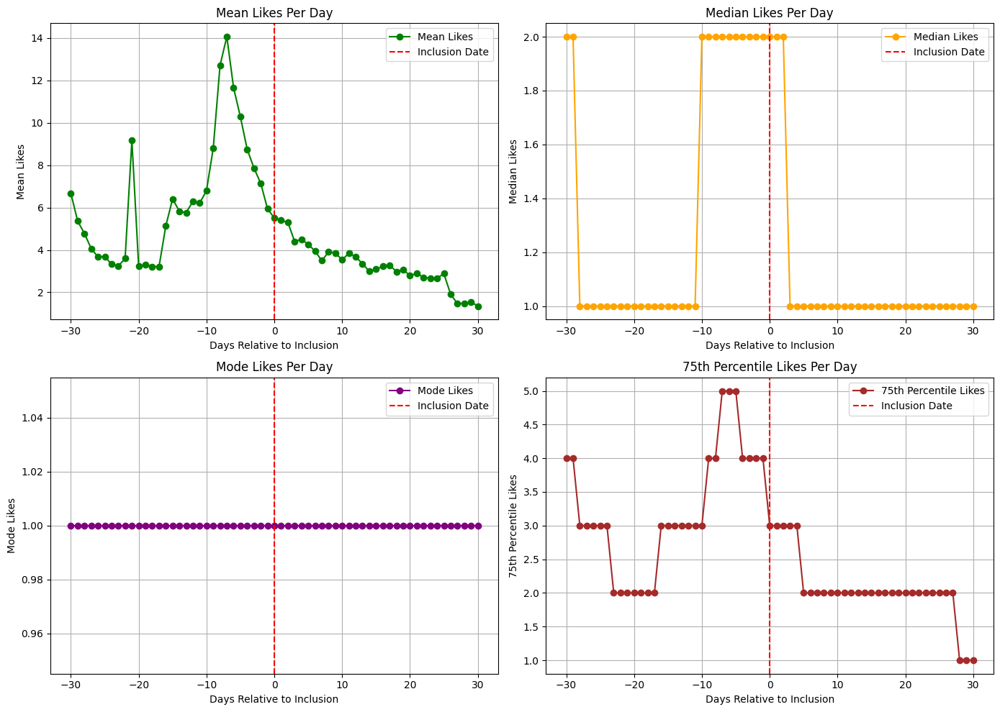

In [3]:
def plot_daily_statistics(daily_stats_df):
    plt.figure(figsize=(14, 10))
    
    # Mean
    plt.subplot(2, 2, 1)
    plt.plot(daily_stats_df['day_offset'], daily_stats_df['mean'], marker='o', label='Mean Likes', color='green')
    plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')
    plt.title('Mean Likes Per Day')
    plt.xlabel("Days Relative to Inclusion")
    plt.ylabel("Mean Likes")
    plt.legend()
    plt.grid()
    
    # Median
    plt.subplot(2, 2, 2)
    plt.plot(daily_stats_df['day_offset'], daily_stats_df['median'], marker='o', label='Median Likes', color='orange')
    plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')
    plt.title('Median Likes Per Day')
    plt.xlabel("Days Relative to Inclusion")
    plt.ylabel("Median Likes")
    plt.legend()
    plt.grid()
    
    # Mode
    plt.subplot(2, 2, 3)
    plt.plot(daily_stats_df['day_offset'], daily_stats_df['mode'], marker='o', label='Mode Likes', color='purple')
    plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')
    plt.title('Mode Likes Per Day')
    plt.xlabel("Days Relative to Inclusion")
    plt.ylabel("Mode Likes")
    plt.legend()
    plt.grid()
    
    # 75th Percentile
    plt.subplot(2, 2, 4)
    plt.plot(daily_stats_df['day_offset'], daily_stats_df['75th_percentile'], marker='o', label='75th Percentile Likes', color='brown')
    plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')
    plt.title('75th Percentile Likes Per Day')
    plt.xlabel("Days Relative to Inclusion")
    plt.ylabel("75th Percentile Likes")
    plt.legend()
    plt.grid()
    
    plt.tight_layout()
    plt.show()

plot_daily_statistics(daily_stats_df)


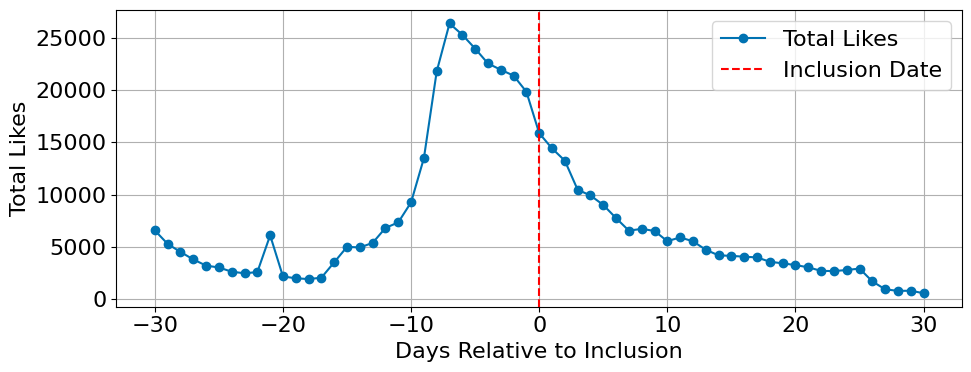

In [6]:

# Plot the results
plt.plot(relative_likes_df['day_offset'], relative_likes_df['likes'], marker='o', label='Total Likes')

# Mark the inclusion date with a red line
plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')

# Add titles and labels
plt.xlabel("Days Relative to Inclusion")
plt.ylabel("Total Likes")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

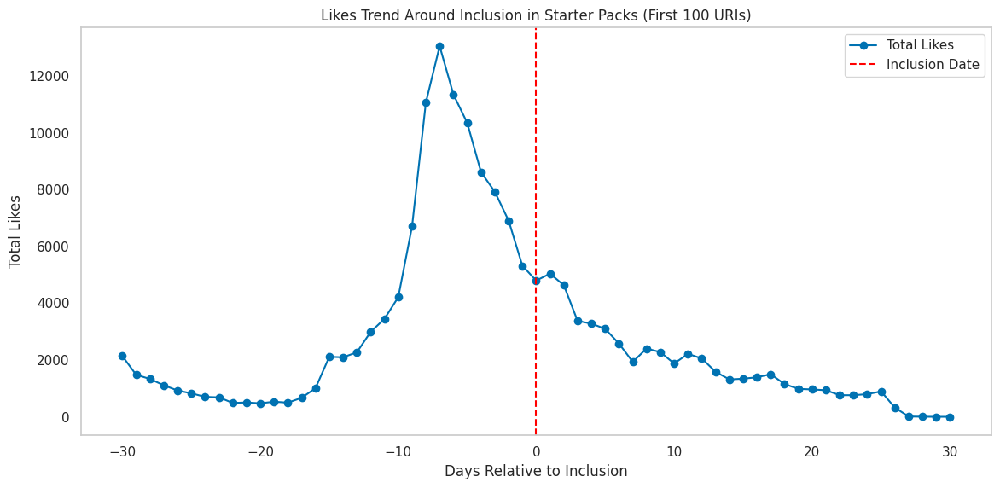

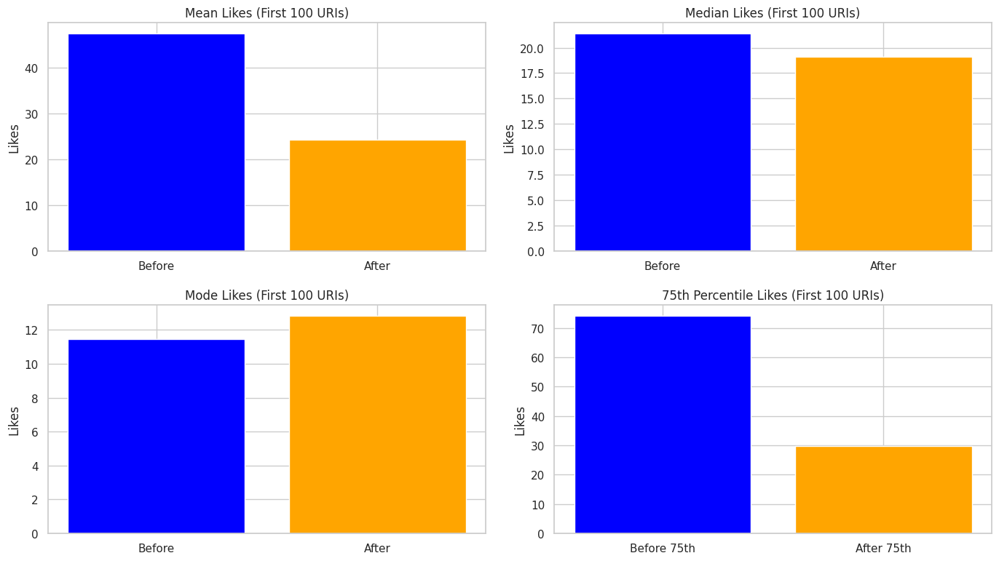

In [25]:
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt
import numpy as np

starter_packs_path = "../../output_and_test_data/starter_packs/starterpacks.csv"
starter_pack_feeds_path = "../../output_and_test_data/starter_packs/starter_pack_feeds.csv"
likes_file_path = "../../output_and_test_data/starter_packs/feed_generator_likes.csv"

starter_packs = pd.read_csv(starter_packs_path)
starter_pack_feeds = pd.read_csv(starter_pack_feeds_path)
likes_data = pd.read_csv(likes_file_path, header=None)

likes_data.columns = ['src', 'dst_did', 'dst_collection', 'dst_rkey', 'created_at']

likes_data = likes_data[likes_data['created_at'] != 'created_at']  # Remove header rows
likes_data['created_at'] = pd.to_datetime(likes_data['created_at'], errors='coerce', format='%Y-%m-%dT%H:%M:%S.%fZ')
likes_data = likes_data.dropna(subset=['created_at'])  # Remove invalid timestamps
likes_data['date'] = likes_data['created_at'].dt.date

likes_data['uri'] = 'at://' + likes_data['dst_did'] + '/' + likes_data['dst_collection'] + '/' + likes_data['dst_rkey']

feeds_to_inclusion_date = {}
for _, row in starter_pack_feeds.iterrows():
    feeds = str(row['feeds']).split(';') if pd.notna(row['feeds']) else []
    matching_rows = starter_packs.loc[starter_packs['uri'] == row['uri']]
    if matching_rows.empty:
        print(f"Warning: No matching 'uri' found for {row['uri']}")
        continue  # Skip this row if no match is found
    inclusion_date = pd.to_datetime(matching_rows['createdAt'].values[0]).tz_localize(None)
    for feed in feeds:
        feeds_to_inclusion_date[feed] = inclusion_date

# Limit to the first 100 URIs
first_100_uris = list(feeds_to_inclusion_date.keys())[:100]
feeds_to_inclusion_date = {uri: feeds_to_inclusion_date[uri] for uri in first_100_uris}

# Aggregate likes data based on URIs (only for the first 100 URIs)
likes_history = defaultdict(lambda: defaultdict(int))  # uri -> date -> likes
for _, row in likes_data.iterrows():
    uri = row['uri']
    if uri in feeds_to_inclusion_date:
        likes_history[uri][row['date']] += 1

# Calculate relative likes around the inclusion date (only for the first 100 URIs)
relative_likes = defaultdict(int)  # day_offset -> total_likes
for uri, inclusion_date in feeds_to_inclusion_date.items():
    for date, likes in likes_history[uri].items():
        date = pd.to_datetime(date).tz_localize(None)
        day_offset = (date - inclusion_date).days
        if -30 <= day_offset <= 30:  # Only consider 30 days before and after inclusion date
            relative_likes[day_offset] += likes

# Prepare the DataFrame for plotting
relative_likes_df = pd.DataFrame.from_dict(relative_likes, orient='index', columns=['likes'])
relative_likes_df.index.name = 'day_offset'
relative_likes_df.reset_index(inplace=True)
relative_likes_df = relative_likes_df.sort_values('day_offset')

# Plot the total likes trend (for the first 100 URIs)
plt.figure(figsize=(12, 6))
plt.plot(relative_likes_df['day_offset'], relative_likes_df['likes'], marker='o', label='Total Likes')

# Mark the inclusion date with a red line
plt.axvline(0, color='red', linestyle='--', label='Inclusion Date')

# Add titles and labels
plt.title("Likes Trend Around Inclusion in Starter Packs (First 100 URIs)")
plt.xlabel("Days Relative to Inclusion")
plt.ylabel("Total Likes")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

# Calculate basic statistics for the first 100 URIs
def calculate_basic_stats(likes_history, feeds_to_inclusion_date):
    stats = []
    for uri, inclusion_date in feeds_to_inclusion_date.items():
        likes_before = []
        likes_after = []
        for date, likes in likes_history[uri].items():
            date = pd.to_datetime(date).tz_localize(None)
            day_offset = (date - inclusion_date).days
            if -30 <= day_offset < 0:  # 30 days before inclusion
                likes_before.append(likes)
            elif 0 < day_offset <= 30:  # 30 days after inclusion
                likes_after.append(likes)
        
        # Calculate statistics for likes before inclusion
        if likes_before:
            stats_before = {
                'uri': uri,
                'period': 'before',
                'mean': np.mean(likes_before),
                'median': np.median(likes_before),
                'mode': pd.Series(likes_before).mode().iloc[0] if not pd.Series(likes_before).mode().empty else None,
                '75th_percentile': np.percentile(likes_before, 75),
                '50th_percentile': np.percentile(likes_before, 50),
            }
            stats.append(stats_before)
        
        # Calculate statistics for likes after inclusion
        if likes_after:
            stats_after = {
                'uri': uri,
                'period': 'after',
                'mean': np.mean(likes_after),
                'median': np.median(likes_after),
                'mode': pd.Series(likes_after).mode().iloc[0] if not pd.Series(likes_after).mode().empty else None,
                '75th_percentile': np.percentile(likes_after, 75),
                '50th_percentile': np.percentile(likes_after, 50),
            }
            stats.append(stats_after)
    
    return pd.DataFrame(stats)

# Calculate statistics for the first 100 URIs
stats_df = calculate_basic_stats(likes_history, feeds_to_inclusion_date)

# Plot additional statistics (for the first 100 URIs)
def plot_statistics(stats_df):
    # Group statistics by period (before/after)
    stats_before = stats_df[stats_df['period'] == 'before']
    stats_after = stats_df[stats_df['period'] == 'after']
    
    # Plot mean, median, and mode
    plt.figure(figsize=(14, 8))
    
    # Mean
    plt.subplot(2, 2, 1)
    plt.bar(['Before', 'After'], [stats_before['mean'].mean(), stats_after['mean'].mean()], color=['blue', 'orange'])
    plt.title('Mean Likes (First 100 URIs)')
    plt.ylabel('Likes')
    
    # Median
    plt.subplot(2, 2, 2)
    plt.bar(['Before', 'After'], [stats_before['median'].mean(), stats_after['median'].mean()], color=['blue', 'orange'])
    plt.title('Median Likes (First 100 URIs)')
    plt.ylabel('Likes')
    
    # Mode
    plt.subplot(2, 2, 3)
    plt.bar(['Before', 'After'], [stats_before['mode'].mean(), stats_after['mode'].mean()], color=['blue', 'orange'])
    plt.title('Mode Likes (First 100 URIs)')
    plt.ylabel('Likes')
    
    # Percentiles
    plt.subplot(2, 2, 4)
    plt.bar(['Before 75th', 'After 75th'], [stats_before['75th_percentile'].mean(), stats_after['75th_percentile'].mean()], color=['blue', 'orange'])
    plt.title('75th Percentile Likes (First 100 URIs)')
    plt.ylabel('Likes')
    
    plt.tight_layout()
    plt.show()

# Plot the additional statistics
plot_statistics(stats_df)

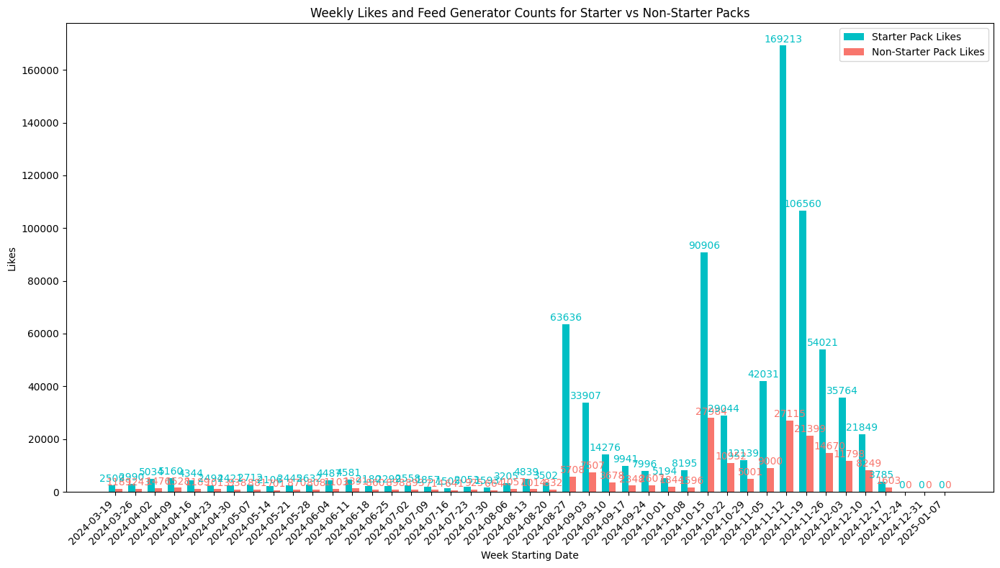

In [1]:
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt
from datetime import datetime, timedelta

feed_generator_info_path = "../../output_and_test_data/starter_packs/starter_packs/feed_generator_info.csv"
likes_file_path = "../../output_and_test_data/starter_packs/starter_packs/feed_generator_likes.csv"

feed_generator_info = pd.read_csv(feed_generator_info_path)
feed_generator_info['uri'] = feed_generator_info['uri'].str.strip()  # Clean URI strings
starter_pack_uris = set(feed_generator_info['uri'])

# Load likes data
likes_data = pd.read_csv(likes_file_path, header=None)
likes_data.columns = ['src', 'dst_did', 'dst_collection', 'dst_rkey', 'created_at']
likes_data = likes_data[likes_data['created_at'] != 'created_at']  # Remove header rows
likes_data['created_at'] = pd.to_datetime(likes_data['created_at'], errors='coerce', format='%Y-%m-%dT%H:%M:%S.%fZ')
likes_data = likes_data.dropna(subset=['created_at'])  # Remove invalid timestamps
likes_data['date'] = likes_data['created_at'].dt.date

# Construct the URI for feed generators
likes_data['uri'] = 'at://' + likes_data['dst_did'] + '/' + likes_data['dst_collection'] + '/' + likes_data['dst_rkey']

# Determine the first like date for each feed generator
first_like_dates = likes_data.groupby('uri')['date'].min().to_dict()

# Map feed generators to their creation dates using the first like date
creation_dates = {uri: first_like_dates.get(uri, None) for uri in starter_pack_uris}

# Aggregate weekly likes for starter and non-starter feed generators
likes_by_week_starter = defaultdict(int)
likes_by_week_non_starter = defaultdict(int)
json_files_by_week_starter = defaultdict(int)
json_files_by_week_non_starter = defaultdict(int)

start_date = datetime(2024, 3, 19)
current_date = datetime.now().date()

# Weekly aggregation
while start_date.date() <= current_date:
    week_start = start_date.date()
    week_end = (start_date + timedelta(days=6)).date()
    weekly_data = likes_data[(likes_data['date'] >= week_start) & (likes_data['date'] <= week_end)]
    
    starter_likes, non_starter_likes = 0, 0
    starter_files, non_starter_files = 0, 0

    for _, row in weekly_data.iterrows():
        uri = row['uri']
        if uri in starter_pack_uris:
            starter_likes += 1
            starter_files += 1
        else:
            non_starter_likes += 1
            non_starter_files += 1
    
    # Store weekly totals
    likes_by_week_starter[week_start.strftime("%Y-%m-%d")] = starter_likes
    likes_by_week_non_starter[week_start.strftime("%Y-%m-%d")] = non_starter_likes
    json_files_by_week_starter[week_start.strftime("%Y-%m-%d")] = starter_files
    json_files_by_week_non_starter[week_start.strftime("%Y-%m-%d")] = non_starter_files
    
    start_date += timedelta(days=7)

# Prepare data for plotting
sorted_weeks = sorted(likes_by_week_starter.keys())
weeks = [week for week in sorted_weeks]

starter_likes = [likes_by_week_starter[week] for week in sorted_weeks]
non_starter_likes = [likes_by_week_non_starter[week] for week in sorted_weeks]
starter_counts = [json_files_by_week_starter[week] for week in sorted_weeks]
non_starter_counts = [json_files_by_week_non_starter[week] for week in sorted_weeks]

# Create grouped bar plot
bar_width = 0.35  # Width of each bar
x = range(len(weeks))  # X positions for the bar groups

plt.figure(figsize=(14, 8))

# Bar plot for starter pack likes
starter_bars = plt.bar(
    [i - bar_width / 2 for i in x],
    starter_likes,
    width=bar_width,
    color='#00BFC4',
    label='Starter Pack Likes'
)

# Bar plot for non-starter pack likes
non_starter_bars = plt.bar(
    [i + bar_width / 2 for i in x],
    non_starter_likes,
    width=bar_width,
    color='#F8766D',
    label='Non-Starter Pack Likes'
)

# Annotate counts on bars
for i, (starter_bar, non_starter_bar) in enumerate(zip(starter_bars, non_starter_bars)):
    # Starter pack count annotation
    plt.text(
        starter_bar.get_x() + starter_bar.get_width() / 2,
        starter_bar.get_height() + 500,  # Adjust based on your data range
        f'{starter_counts[i]}',
        ha='center',
        va='bottom',
        fontsize=10,
        color='#00BFC4'
    )
    # Non-starter pack count annotation
    plt.text(
        non_starter_bar.get_x() + non_starter_bar.get_width() / 2,
        non_starter_bar.get_height() + 500,  # Adjust based on your data range
        f'{non_starter_counts[i]}',
        ha='center',
        va='bottom',
        fontsize=10,
        color='#F8766D'
    )

# Formatting
plt.xlabel('Week Starting Date')
plt.ylabel('Likes')
plt.title('Weekly Likes and Feed Generator Counts for Starter vs Non-Starter Packs')
plt.xticks(ticks=x, labels=weeks, rotation=45, ha='right')
plt.legend()

plt.tight_layout()
plt.show()

Week: 2024-03-19 - Likes: 228989, JSON Files Processed: 5985
Week: 2024-03-26 - Likes: 231059, JSON Files Processed: 5985
Week: 2024-04-02 - Likes: 235966, JSON Files Processed: 6162
Week: 2024-04-09 - Likes: 240550, JSON Files Processed: 6161
Week: 2024-04-16 - Likes: 244972, JSON Files Processed: 6165
Week: 2024-04-23 - Likes: 248746, JSON Files Processed: 6171
Week: 2024-04-30 - Likes: 250723, JSON Files Processed: 6172
Week: 2024-05-07 - Likes: 252729, JSON Files Processed: 6176
Week: 2024-05-14 - Likes: 254831, JSON Files Processed: 6178
Week: 2024-07-02 - Likes: 271337, JSON Files Processed: 6182
Week: 2024-07-09 - Likes: 272711, JSON Files Processed: 6178
Week: 2024-07-16 - Likes: 274222, JSON Files Processed: 6183
Week: 2024-07-23 - Likes: 275558, JSON Files Processed: 6187
Week: 2024-07-30 - Likes: 277104, JSON Files Processed: 6190
Week: 2024-08-06 - Likes: 278351, JSON Files Processed: 6187
Week: 2024-08-13 - Likes: 280943, JSON Files Processed: 6188
Week: 2024-08-20 - Likes

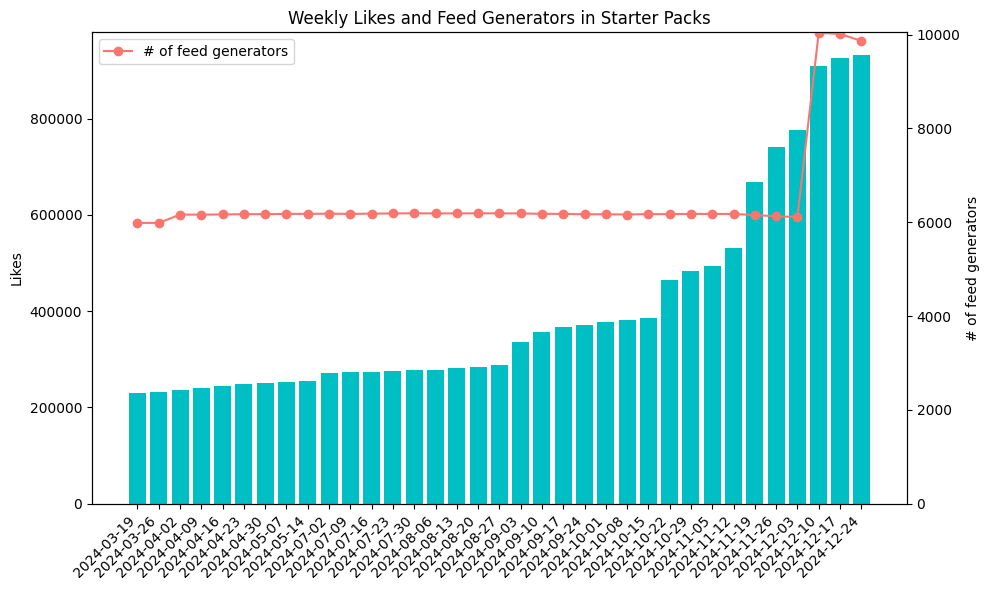

In [22]:
import os
import json
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt
from datetime import datetime, timedelta

feed_generator_info_path = "../../output_and_test_data/starter_packs/starter_packs/feed_generator_info.csv"
metadata_dir = "../../output_and_test_data/feed_generators/downloaded_metadata_new"

feed_generator_info = pd.read_csv(feed_generator_info_path)
starter_pack_uris = set(feed_generator_info['uri'])

likes_by_week = defaultdict(int)
json_files_by_week = defaultdict(int)

start_date = datetime(2024, 3, 19)
current_date = datetime.now().date()


while start_date.date() <= current_date:
    end_date = start_date + timedelta(days=6)
    week_directory = os.path.join(metadata_dir, start_date.strftime("%Y-%m-%d"))
    
    if os.path.isdir(week_directory):
        total_likes = 0
        total_json_files = 0
        
        for user_folder in os.listdir(week_directory):
            user_folder_path = os.path.join(week_directory, user_folder)
            
            if os.path.isdir(user_folder_path):
                for json_file in os.listdir(user_folder_path):
                    if json_file.endswith('.json'):
                        json_file_path = os.path.join(user_folder_path, json_file)
                    
                        try:
                            with open(json_file_path, "r") as f:
                                try:
                                    data = json.load(f)
                                    uri = data["view"].get("uri")
                                    if uri in starter_pack_uris:  # Filter only starter pack URIs
                                        like_count = data["view"].get("likeCount", 0)
                                        total_likes += like_count
                                        total_json_files += 1
                                except json.JSONDecodeError:
                                    print(f"Error decoding JSON in file: {json_file_path}")
                        except OSError as e:
                            print(f"Error opening file: {json_file_path}, {e}")
        
        likes_by_week[start_date.strftime("%Y-%m-%d")] = total_likes
        json_files_by_week[start_date.strftime("%Y-%m-%d")] = total_json_files
        
        print(f"Week: {start_date.strftime('%Y-%m-%d')} - Likes: {total_likes}, JSON Files Processed: {total_json_files}")
    
    start_date += timedelta(days=7)

sorted_weeks = sorted(likes_by_week.keys())
weeks = [week for week in sorted_weeks]
total_likes = [likes_by_week[week] for week in sorted_weeks]
total_json_files = [json_files_by_week[week] for week in sorted_weeks]

plt.figure(figsize=(10, 6))

plt.bar(weeks, total_likes, label='Likes', color='#00BFC4')
plt.ylabel('Likes')
plt.xticks(rotation=45, ha='right')

plt.twinx()
plt.plot(weeks, total_json_files, color='#F8766D', label='# of feed generators', marker='o')
plt.ylabel('# of feed generators')

plt.title('Weekly Likes and Feed Generators in Starter Packs')
plt.legend(loc='upper left')
plt.ylim(0, max(total_json_files) + 10)

plt.tight_layout()
plt.show()


In [2]:
import pandas as pd
from datetime import datetime

# File paths
starter_packs_path = "../../output_and_test_data/starter_packs/starter_packs/starterpacks.csv"
starter_pack_feeds_path = "../../output_and_test_data/starter_packs/starter_packs/starter_pack_feeds.csv"

# Load CSV files
starter_packs = pd.read_csv(starter_packs_path)
starter_pack_feeds = pd.read_csv(starter_pack_feeds_path)

# Map feeds to their first inclusion date
feeds_to_inclusion_date = {}
for _, row in starter_pack_feeds.iterrows():
    feeds = str(row['feeds']).split(';') if pd.notna(row['feeds']) else []
    matching_rows = starter_packs.loc[starter_packs['uri'] == row['uri'], 'createdAt']
    
    if matching_rows.empty:
        print(f"Warning: 'uri' {row['uri']} not found in starter_packs. Skipping.")
        continue
    
    inclusion_date = pd.to_datetime(matching_rows.values[0]).tz_localize(None)  # Remove timezone information
    for feed in feeds:
        if feed not in feeds_to_inclusion_date or inclusion_date < feeds_to_inclusion_date[feed]:
            feeds_to_inclusion_date[feed] = inclusion_date

# Create a DataFrame with unique feed URIs and their inclusion dates
feed_inclusion_data = [
    {'uri': feed, 'first_inclusion_date': date}
    for feed, date in feeds_to_inclusion_date.items()
]

feed_inclusion_df = pd.DataFrame(feed_inclusion_data)

# Save to CSV
output_path = "/home/addr777/development/saidu/bluesky/feed_generators/output_and_test_data/feed_inclusion_dates.csv"
feed_inclusion_df.to_csv(output_path, index=False)

print(f"Feed inclusion data saved to {output_path}")


Feed inclusion data saved to /home/addr777/development/saidu/bluesky/feed_generators/output_and_test_data/feed_inclusion_dates.csv


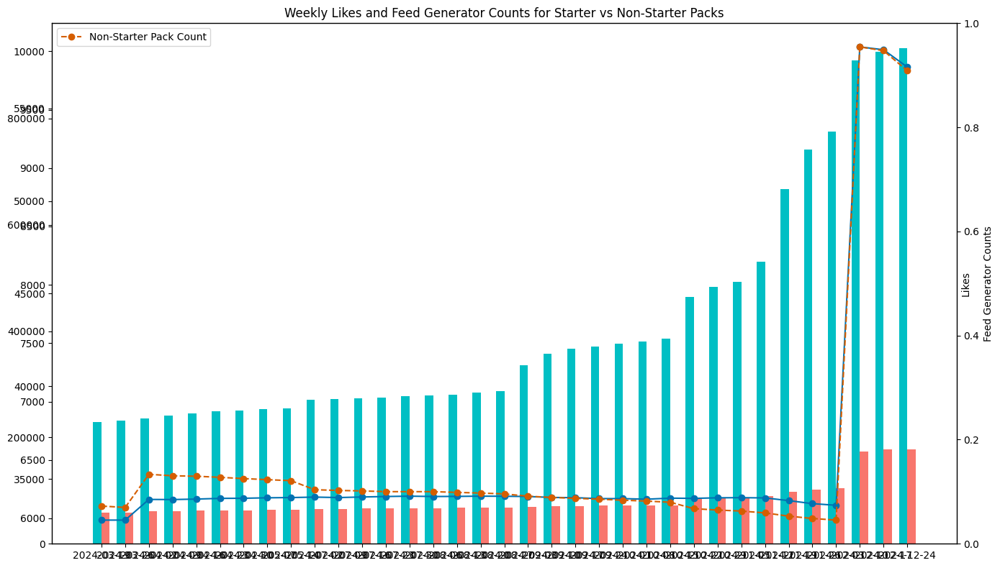

In [ ]:
from collections import defaultdict
from datetime import datetime
import os
import json
import pandas as pd
import matplotlib.pyplot as plt

# Step 1: Initialize a defaultdict for historical likes
likes_history = defaultdict(lambda: defaultdict(int))  # uri -> date -> likes

# Directory where metadata is stored
directory = "../../output_and_test_data/feed_generators/downloaded_metadata_new"

# Step 2: Traverse directories and collect likes data
for date_folder in os.listdir(directory):
    date_path = os.path.join(directory, date_folder)
    if os.path.isdir(date_path):
        for user_folder in os.listdir(date_path):
            user_folder_path = os.path.join(date_path, user_folder)
            if os.path.isdir(user_folder_path):
                for json_file in os.listdir(user_folder_path):
                    if json_file.endswith('.json'):
                        json_file_path = os.path.join(user_folder_path, json_file)
                        try:
                            with open(json_file_path, "r") as f:
                                try:
                                    data = json.load(f)
                                    like_count = data["view"]["likeCount"]
                                    uri = data["view"].get("uri", None)
                                    if uri:
                                        likes_history[uri][date_folder] += like_count
                                except json.JSONDecodeError:
                                    print(f"Error decoding JSON in file: {json_file_path}")
                        except OSError as e:
                            print(f"Error opening file: {json_file_path}, {e}")

# Step 3: Flatten the likes history into a DataFrame
likes_history_df = []
for uri, dates in likes_history.items():
    for date, likes in dates.items():
        likes_history_df.append({'uri': uri, 'date': date, 'likes': likes})

likes_history_df = pd.DataFrame(likes_history_df)

# Step 4: Load inclusion dates for feed generators
starter_pack_dates = pd.read_csv('/path/to/starter_pack_dates.csv')  # Update path as needed

# Merge inclusion dates into likes_history_df
likes_history_df = pd.merge(
    likes_history_df,
    starter_pack_dates,
    on='uri',
    how='left'
)

# Convert date columns to datetime
likes_history_df['date'] = pd.to_datetime(likes_history_df['date'])
likes_history_df['inclusion_date'] = pd.to_datetime(likes_history_df['inclusion_date'])

# Step 5: Add a 'period' column to classify likes as before or after inclusion
likes_history_df['period'] = likes_history_df.apply(
    lambda row: 'Before Inclusion' if row['date'] < row['inclusion_date'] else 'After Inclusion',
    axis=1
)

# Step 6: Aggregate likes by feed generator and period
likes_summary = (
    likes_history_df.groupby(['uri', 'period'])['likes']
    .sum()
    .unstack(fill_value=0)
    .reset_index()
)

# Rename columns for clarity
likes_summary.columns = ['uri', 'Before Inclusion', 'After Inclusion']

# Step 7: Plot the data
likes_summary.plot(
    x='uri',
    kind='bar',
    stacked=True,
    figsize=(14, 7),
    color=['skyblue', 'orange'],
    title='Likes Before and After Inclusion in Starter Packs'
)

plt.ylabel('Total Likes')
plt.xlabel('Feed Generators')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Period')
plt.tight_layout()
plt.show()


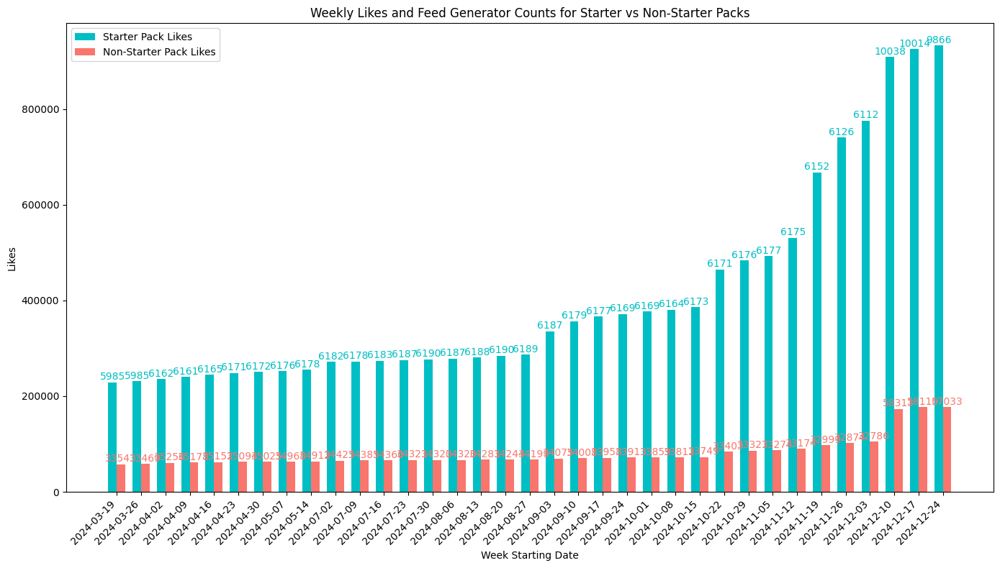

In [26]:
import os
import json
import pandas as pd
from collections import defaultdict
import matplotlib.pyplot as plt
from datetime import datetime, timedelta

# File paths
feed_generator_info_path = "../../output_and_test_data/starter_packs/starter_packs/feed_generator_info.csv"
metadata_dir = "../output_and_test_data/downloaded_metadata_new"

# Load the list of URIs for starter packs
feed_generator_info = pd.read_csv(feed_generator_info_path)
starter_pack_uris = set(feed_generator_info['uri'])

# Initialize variables for weekly aggregation
likes_by_week_starter = defaultdict(int)
likes_by_week_non_starter = defaultdict(int)
json_files_by_week_starter = defaultdict(int)
json_files_by_week_non_starter = defaultdict(int)

start_date = datetime(2024, 3, 19)
current_date = datetime.now().date()

# Process metadata directory
while start_date.date() <= current_date:
    week_directory = os.path.join(metadata_dir, start_date.strftime("%Y-%m-%d"))
    
    if os.path.isdir(week_directory):
        starter_likes, non_starter_likes = 0, 0
        starter_files, non_starter_files = 0, 0
        
        for user_folder in os.listdir(week_directory):
            user_folder_path = os.path.join(week_directory, user_folder)
            if os.path.isdir(user_folder_path):
                for json_file in os.listdir(user_folder_path):
                    if json_file.endswith('.json'):
                        json_file_path = os.path.join(user_folder_path, json_file)
                        try:
                            with open(json_file_path, "r") as f:
                                data = json.load(f)
                                uri = data["view"].get("uri")
                                like_count = data["view"].get("likeCount", 0)
                                if uri in starter_pack_uris:
                                    starter_likes += like_count
                                    starter_files += 1
                                else:
                                    non_starter_likes += like_count
                                    non_starter_files += 1
                        except (json.JSONDecodeError, OSError) as e:
                            print(f"Error with file: {json_file_path}, {e}")
        
        likes_by_week_starter[start_date.strftime("%Y-%m-%d")] = starter_likes
        likes_by_week_non_starter[start_date.strftime("%Y-%m-%d")] = non_starter_likes
        json_files_by_week_starter[start_date.strftime("%Y-%m-%d")] = starter_files
        json_files_by_week_non_starter[start_date.strftime("%Y-%m-%d")] = non_starter_files
    
    start_date += timedelta(days=7)

# Prepare data for plotting
sorted_weeks = sorted(likes_by_week_starter.keys())
weeks = [week for week in sorted_weeks]

starter_likes = [likes_by_week_starter[week] for week in sorted_weeks]
non_starter_likes = [likes_by_week_non_starter[week] for week in sorted_weeks]
starter_counts = [json_files_by_week_starter[week] for week in sorted_weeks]
non_starter_counts = [json_files_by_week_non_starter[week] for week in sorted_weeks]

# Create grouped bar plot
bar_width = 0.35  # Width of each bar
x = range(len(weeks))  # X positions for the bar groups

plt.figure(figsize=(14, 8))

# Bar plot for starter pack likes
starter_bars = plt.bar(
    [i - bar_width / 2 for i in x],
    starter_likes,
    width=bar_width,
    color='#00BFC4',
    label='Starter Pack Likes'
)

# Bar plot for non-starter pack likes
non_starter_bars = plt.bar(
    [i + bar_width / 2 for i in x],
    non_starter_likes,
    width=bar_width,
    color='#F8766D',
    label='Non-Starter Pack Likes'
)

# Annotate counts on bars
for i, (starter_bar, non_starter_bar) in enumerate(zip(starter_bars, non_starter_bars)):
    # Starter pack count annotation
    plt.text(
        starter_bar.get_x() + starter_bar.get_width() / 2,
        starter_bar.get_height() + 500,  # Adjust based on your data range
        f'{starter_counts[i]}',
        ha='center',
        va='bottom',
        fontsize=10,
        color='#00BFC4'
    )
    # Non-starter pack count annotation
    plt.text(
        non_starter_bar.get_x() + non_starter_bar.get_width() / 2,
        non_starter_bar.get_height() + 500,  # Adjust based on your data range
        f'{non_starter_counts[i]}',
        ha='center',
        va='bottom',
        fontsize=10,
        color='#F8766D'
    )

# Formatting
plt.xlabel('Week Starting Date')
plt.ylabel('Likes')
plt.title('Weekly Likes and Feed Generator Counts for Starter vs Non-Starter Packs')
plt.xticks(ticks=x, labels=weeks, rotation=45, ha='right')
plt.legend()

plt.tight_layout()
plt.show()


                                did           rkey post_languages  \
0  did:plc:b7nwyonilwymqnwhomv6yfvy  3ldvsxxc2722o         ["en"]   
1  did:plc:mvoqbh3jm3v2cqsc5dj3wcfe  3ldvsxzoj7e2n         ["th"]   
2  did:plc:zgwypjud5u4qss3dubzpphmi  3ldvsy4it4c2a         ["en"]   
3  did:plc:uld74vzf773y7ovqqm2jfaft  3ldvsyn4dvl2c    ["Unknown"]   
4  did:plc:iukv4ukkbboxv43qex456qpz  3lckzed5x4s2e         ["ja"]   

            post_created_at  \
0  2024-12-22T16:18:43.493Z   
1  2024-12-22T16:18:45.317Z   
2  2024-12-22T16:18:48.958Z   
3      2024-12-22T16:19:06Z   
4  2024-12-05T15:48:32.295Z   

                                           post_text  \
0  In other words, it is defined more by its bad ...   
1  ลุงคนปล่อยเช่ารถถ้าจะด่าจะเกลียดก็ทำต่อหน้าเลย...   
2                             What a game we had. ❤️   
3  Почему ValueZone AI — Лучшая Универсальная Пла...   
4                   やっぱ教育の電子化をするのは良くないよなぁ...まー見づらいこと   

                                          reply_root  \
0  at

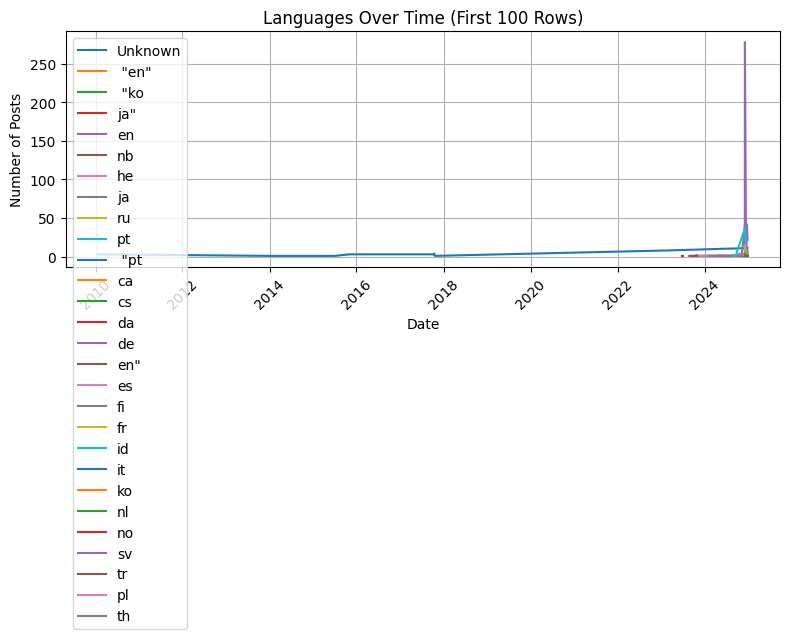

In [1]:
import pandas as pd
import gzip
import matplotlib.pyplot as plt

# File path
file_path = "/mnt/data3/bluesky/posts.csv.gz"

# Read the first 100 rows automatically detecting the structure
with gzip.open(file_path, 'rt') as f:
    df = pd.read_csv(f, nrows=681)

# Inspect the DataFrame (Optional)
print(df.head())
print(df.columns)

# Parse `post_languages` and `post_created_at`
df['post_languages'] = df['post_languages'].str.strip('[]"').str.split(",")
df['post_created_at'] = pd.to_datetime(df['post_created_at'], errors='coerce')  # Invalid dates become NaT

# Check for rows where 'post_created_at' is NaT
invalid_dates = df[df['post_created_at'].isna()]

if not invalid_dates.empty:
    print("\nRows with invalid 'post_created_at' values:")
    print(invalid_dates)  # Print the problematic rows

# Drop rows where 'post_created_at' is NaT (invalid date)
df = df.dropna(subset=['post_created_at'])

# Verify that 'post_created_at' is now in datetime format
print("\n'post_created_at' column dtype after conversion:", df['post_created_at'].dtype)

# Explode languages into individual rows
df_exploded = df.explode('post_languages')

# Aggregate data (count languages per day)
df_grouped = df_exploded.groupby([df_exploded['post_created_at'].dt.date, 'post_languages']).size().reset_index(name='count')

# Plot data
plt.figure(figsize=(8, 5))
for language in df_grouped['post_languages'].unique():
    lang_data = df_grouped[df_grouped['post_languages'] == language]
    plt.plot(lang_data['post_created_at'], lang_data['count'], label=language)

plt.title("Languages Over Time (First 100 Rows)")
plt.xlabel("Date")
plt.ylabel("Number of Posts")
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import gzip
import matplotlib.pyplot as plt

# File path
file_path = "/mnt/data3/bluesky/posts.csv.gz"

# Read the first 682 rows to get row 682 specifically
with gzip.open(file_path, 'rt') as f:
    df = pd.read_csv(f, nrows=100000000)

# Normalize 'post_languages' to remove extra spaces, quotes, and make them lowercase
df['post_languages'] = df['post_languages'].str.strip('[]"').str.split(",").apply(
    lambda x: [i.strip().lower().replace('"', '') for i in x if i.strip()]  # Remove empty entries
)

# Parse 'post_created_at' as datetime
df['post_created_at'] = pd.to_datetime(df['post_created_at'], errors='coerce', utc=True)

# Check for rows where 'post_created_at' is NaT
invalid_dates = df[df['post_created_at'].isna()]

if not invalid_dates.empty:
    print("\nRows with invalid 'post_created_at' values:")
    print(invalid_dates)  # Print the problematic rows

# Drop rows where 'post_created_at' is NaT (invalid date)
df = df.dropna(subset=['post_created_at'])

df_exploded = df.explode('post_languages')

language_counts = df_exploded['post_languages'].value_counts()

top_languages = language_counts.head(20).index
df_exploded['post_languages'] = df_exploded['post_languages'].apply(
    lambda x: x if x in top_languages else 'Others'
)

df_grouped = df_exploded.groupby([df_exploded['post_created_at'].dt.date, 'post_languages']).size().reset_index(name='count')

df_pivot = df_grouped.pivot_table(index='post_created_at', columns='post_languages', values='count', aggfunc='sum', fill_value=0)

plt.figure(figsize=(10, 6))
df_pivot.plot(kind='area', stacked=True, figsize=(10, 6), alpha=0.6)

plt.title("Growth of Top 20 Languages Over Time (First 682 Rows)")
plt.xlabel("Date")
plt.ylabel("Number of Posts")
plt.legend(title='Languages')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
from textblob import TextBlob

file_path = '/mnt/data3/bluesky/starter_pack_mentions.csv'  # Update this to your file's path

try:
    data = pd.read_csv(
        file_path,
        engine='python',          
        error_bad_lines=False,    
        quoting=3,               
    )
except Exception as e:
    print(f"Error reading the file: {e}")
    exit()

# Extract the required columns
columns_to_keep = ['did', 'rkey', 'post_languages', 'post_created_at', 'post_text']
missing_columns = [col for col in columns_to_keep if col not in data.columns]

if not missing_columns:
    extracted_data = data[columns_to_keep]
    
    def analyze_sentiment(text):
        if pd.isna(text):
            return None 
        analysis = TextBlob(text)
        return analysis.sentiment.polarity  

    extracted_data['sentiment_score'] = extracted_data['post_text'].apply(analyze_sentiment)
    
    def categorize_sentiment(score):
        if score is None:
            return 'Neutral'
        elif score > 0:
            return 'Positive'
        elif score < 0:
            return 'Negative'
        else:
            return 'Neutral'

    extracted_data['sentiment_category'] = extracted_data['sentiment_score'].apply(categorize_sentiment)

    output_file = 'processed_posts_with_sentiment.csv'
    extracted_data.to_csv(output_file, index=False)

    print(f"Processed data with sentiment analysis saved to '{output_file}'.")
else:
    print(f"Missing columns in dataset: {missing_columns}")

In [13]:
import csv
import gzip
import re
import sys

def extract_starter_pack_mentions(file_path, output_file_path):
    pattern = r'\bstarter\s?packs?\b'

    csv.field_size_limit(sys.maxsize)  # max size available on system

    with gzip.open(file_path, 'rt', encoding='utf-8') as infile, open(output_file_path, 'w', newline='', encoding='utf-8') as outfile:
        reader = csv.reader(infile)
        writer = csv.writer(outfile)

        header = next(reader)
        writer.writerow(header)
        
        for row in reader:
            try:
                post_text = row[4] if len(row) > 4 else ""  # Assuming post_text is in the 5th column (index 4)
                
                if re.search(pattern, post_text, re.IGNORECASE):
                    writer.writerow(row)
            except Exception as e:
                print(f"Skipping row due to error: {e}")
                continue  # Skip this row and move to the next

file_path = '/mnt/data3/bluesky/posts.csv.gz'  # Original file path
output_file_path = '../../output_and_test_data/starter_packs/starter_pack_mentions_in_posts_new.csv'  # Output file path

extract_starter_pack_mentions(file_path, output_file_path)

print(f"Extraction complete. Results saved to {output_file_path}")

Extraction complete. Results saved to /home/addr777/development/saidu/bluesky/feed_generators/output_and_test_data/starter_packs/starter_pack_mentions_in_posts_new.csv


Total Posts: 363999
Positive Posts: 176648
Neutral Posts: 163224
Negative Posts: 24127


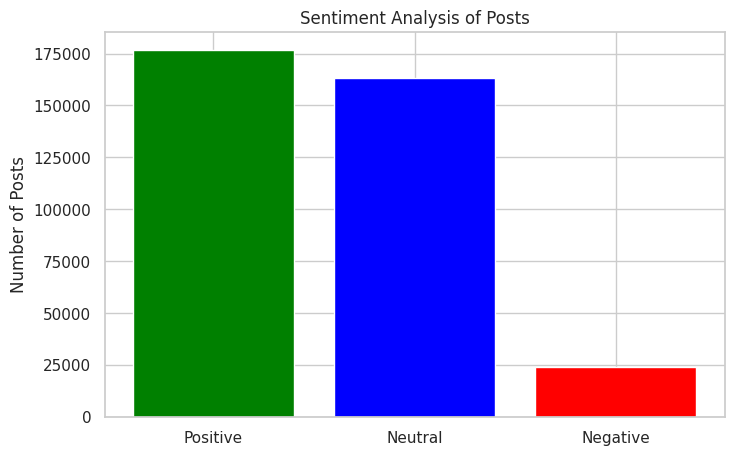

In [29]:
import csv
from textblob import TextBlob
import matplotlib.pyplot as plt

def perform_sentiment_analysis(input_file):
    sentiment_counts = {"Positive": 0, "Neutral": 0, "Negative": 0}
    total_posts = 0
    
    with open(input_file, 'r', encoding='utf-8') as infile:
        reader = csv.DictReader(infile)
        
        for row in reader:
            try:
                total_posts += 1
                post_text = row.get("post_text", "")
                
                # sentiment analysis
                blob = TextBlob(post_text)
                sentiment_polarity = blob.sentiment.polarity
                
                if sentiment_polarity > 0.1:
                    sentiment_counts["Positive"] += 1
                elif sentiment_polarity < -0.1:
                    sentiment_counts["Negative"] += 1
                else:
                    sentiment_counts["Neutral"] += 1

            except Exception as e:
                print(f"Error processing row: {e}")
                continue
    
    return sentiment_counts, total_posts

def plot_sentiment_analysis(sentiment_counts):
    # Create a bar chart
    categories = list(sentiment_counts.keys())
    counts = list(sentiment_counts.values())

    plt.figure(figsize=(8, 5))
    plt.bar(categories, counts, color=['green', 'blue', 'red'])
    plt.title('Sentiment Analysis of Posts')
    plt.ylabel('Number of Posts')
    plt.show()

input_csv_file = "../../output_and_test_data/starter_packs/starter_pack_mentions_in_posts.csv"

sentiment_counts, total_posts = perform_sentiment_analysis(input_csv_file)

print(f"Total Posts: {total_posts}")
print(f"Positive Posts: {sentiment_counts['Positive']}")
print(f"Neutral Posts: {sentiment_counts['Neutral']}")
print(f"Negative Posts: {sentiment_counts['Negative']}")

plot_sentiment_analysis(sentiment_counts)

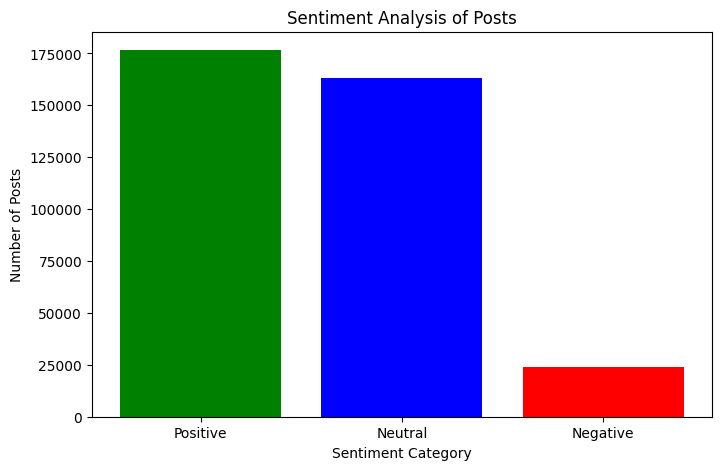

Negative posts have been extracted to /home/addr777/development/saidu/bluesky/feed_generators/output_and_test_data/starter_packs/negative_posts.csv


In [2]:
import csv
from textblob import TextBlob
import matplotlib.pyplot as plt

def perform_sentiment_analysis_and_extract_negatives(input_file, output_file):
    sentiment_counts = {"Positive": 0, "Neutral": 0, "Negative": 0}

    with open(input_file, 'r', encoding='utf-8') as infile, open(output_file, 'w', encoding='utf-8', newline='') as outfile:
        reader = csv.DictReader(infile)
        fieldnames = reader.fieldnames  # Preserve the column names
        writer = csv.DictWriter(outfile, fieldnames=fieldnames)
        
        writer.writeheader()  

        for row in reader:
            try:
                post_text = row.get("post_text", "")
                
                blob = TextBlob(post_text)
                sentiment_polarity = blob.sentiment.polarity
                
                if sentiment_polarity > 0.1:
                    sentiment_counts["Positive"] += 1
                elif sentiment_polarity < -0.1:  
                    sentiment_counts["Negative"] += 1
                    writer.writerow(row) 
                else:
                    sentiment_counts["Neutral"] += 1

            except Exception as e:
                print(f"Error processing row: {e}")
                continue

    return sentiment_counts

def plot_sentiment_analysis(sentiment_counts):
    # Create a bar chart
    categories = list(sentiment_counts.keys())
    counts = list(sentiment_counts.values())

    plt.figure(figsize=(8, 5))
    plt.bar(categories, counts, color=['green', 'blue', 'red'])
    plt.title('Sentiment Analysis of Posts')
    plt.xlabel('Sentiment Category')
    plt.ylabel('Number of Posts')
    plt.show()

input_csv_file = "../../output_and_test_data/starter_packs/starter_pack_mentions_in_posts.csv"
output_csv_file = "../../output_and_test_data/starter_packs/negative_posts.csv"

sentiment_counts = perform_sentiment_analysis_and_extract_negatives(input_csv_file, output_csv_file)

# Plot the results
plot_sentiment_analysis(sentiment_counts)

print(f"Negative posts have been extracted to {output_csv_file}")

0   2024-09-15 20:04:02.803000+00:00
1   2024-12-05 15:49:11.934000+00:00
2   2024-11-16 02:27:00.481000+00:00
3   2024-12-05 15:48:43.284000+00:00
4   2024-12-05 15:49:24.736000+00:00
Name: date, dtype: datetime64[ns, UTC]
date         datetime64[ns, UTC]
sentiment                 object
dtype: object


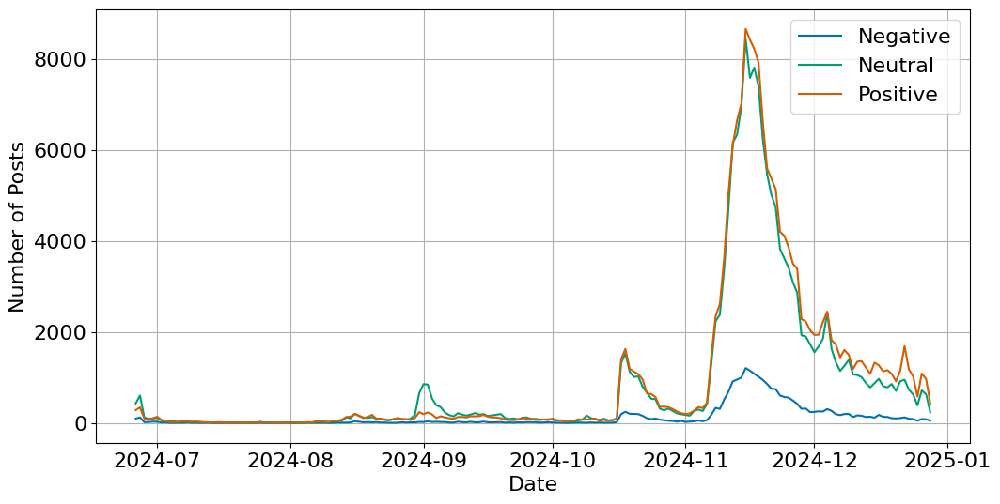

In [16]:
import csv
from textblob import TextBlob
import matplotlib.pyplot as plt
from datetime import datetime
import pandas as pd

def perform_sentiment_analysis_and_extract_negatives(input_file, output_file):
    sentiment_counts = {"Positive": 0, "Neutral": 0, "Negative": 0}
    sentiment_over_time = []

    with open(input_file, 'r', encoding='utf-8') as infile, open(output_file, 'w', encoding='utf-8', newline='') as outfile:
        reader = csv.DictReader(infile)
        fieldnames = reader.fieldnames
        writer = csv.DictWriter(outfile, fieldnames=fieldnames)
        writer.writeheader()

        for row in reader:
            try:
                post_text = row.get("post_text", "")
                post_created_at = row.get("post_created_at", "")
                
                blob = TextBlob(post_text)
                sentiment_polarity = blob.sentiment.polarity
                
                if sentiment_polarity > 0.1:
                    sentiment = "Positive"
                    sentiment_counts["Positive"] += 1
                elif sentiment_polarity < -0.1:
                    sentiment = "Negative"
                    sentiment_counts["Negative"] += 1
                    writer.writerow(row)  # Write negative posts to output file
                else:
                    sentiment = "Neutral"
                    sentiment_counts["Neutral"] += 1
                
                # Store sentiment and date
                sentiment_over_time.append({
                    "date": post_created_at,
                    "sentiment": sentiment
                })

            except Exception as e:
                print(f"Error processing row: {e}")
                continue

    return sentiment_counts, sentiment_over_time

def plot_sentiment_over_time(sentiment_over_time):
    df = pd.DataFrame(sentiment_over_time)

    # Parse the date column
    try:
        df['date'] = pd.to_datetime(df['date'], utc=True, errors='coerce')  # Convert to datetime, enforce UTC
        print(df['date'].head())  # Debug: Check parsed dates
    except Exception as e:
        print(f"Error parsing dates: {e}")
        return

    # Filter for dates after 2022
    df = df[df['date'] >= pd.Timestamp('2024-06-26', tz='UTC')]

    df = df.dropna(subset=['date'])
    print(df.dtypes)  # Debug: Confirm 'date' is datetime64

    try:
        sentiment_trend = df.groupby([df['date'].dt.date, 'sentiment']).size().unstack(fill_value=0)
    except Exception as e:
        print(f"Error during grouping: {e}")
        return

    # Plot the sentiment trends
    plt.figure(figsize=(12, 6))
    for sentiment in sentiment_trend.columns:
        plt.plot(sentiment_trend.index, sentiment_trend[sentiment], label=sentiment)

    # plt.title('Sentiment Analysis Over Time (After 2022)')
    plt.xlabel('Date')
    plt.ylabel('Number of Posts')
    plt.legend()
    plt.grid(True)
    plt.show()    
input_csv_file = "../../output_and_test_data/starter_packs/starter_pack_mentions_in_posts.csv"
output_csv_file = "../../output_and_test_data/starter_packs/negative_posts.csv"

sentiment_counts, sentiment_over_time = perform_sentiment_analysis_and_extract_negatives(input_csv_file, output_csv_file)

plot_sentiment_over_time(sentiment_over_time)

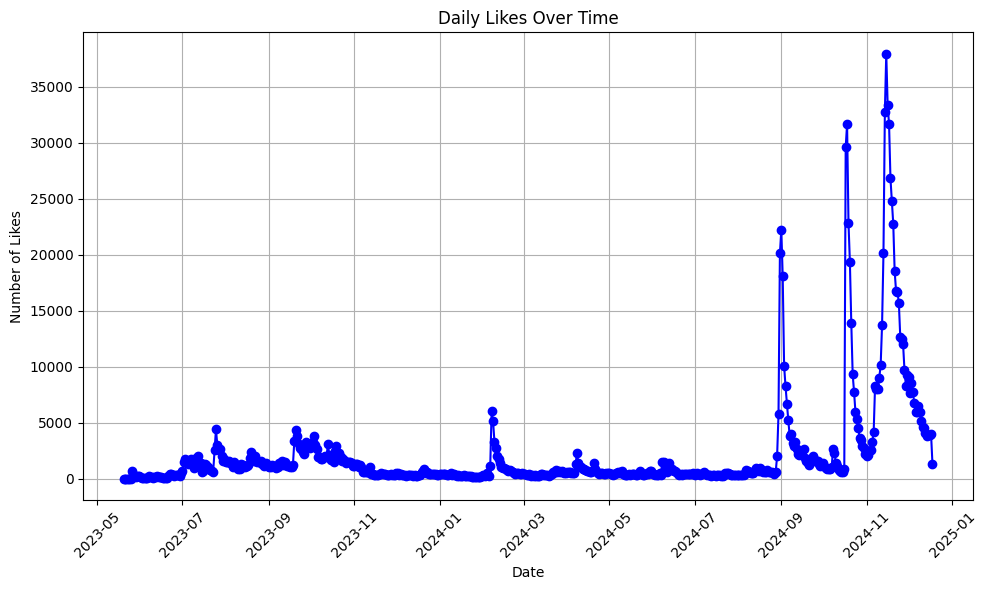

In [1]:
import pandas as pd
import matplotlib.pyplot as plt

file_path = '../../output_and_test_data/starter_packs/feed_generator_likes.csv'

data = pd.read_csv(file_path, header=None)

data.columns = ['src', 'dst_did', 'dst_collection', 'dst_rkey', 'created_at']
data = data[data['created_at'] != 'created_at']
data['created_at'] = pd.to_datetime(data['created_at'], errors='coerce', format='%Y-%m-%dT%H:%M:%S.%fZ')
data = data.dropna(subset=['created_at'])
data['date'] = data['created_at'].dt.date

daily_likes = data.groupby('date').size()

plt.figure(figsize=(10, 6))
daily_likes.plot(kind='line', marker='o', color='b')
plt.title('Daily Likes Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Likes')
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

plt.show()

In [ ]:
from nltk.stem import WordNetLemmatizer
import nltk
import pandas as pd
import plotly.graph_objects as go
import re
from collections import defaultdict
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import random

nltk.download('wordnet')
nltk.download('omw-1.4')

lemmatizer = WordNetLemmatizer()
file_path = "../data/classified_posts/classified_starter_packs_hpc.csv"
df = pd.read_csv(file_path)

def generate_random_color():
    return f"rgba({random.randint(0, 255)}, {random.randint(0, 255)}, {random.randint(0, 255)}, 0.6)"

def normalize_classification(text, is_starter_pack=False):
    if pd.isna(text):
        return ""
    text = text.lower()
    text = re.sub(r"\(.*?\)", "", text)
    text = re.sub(r"-.*", "", text).strip()
    if "n/a" in text or "unknown" in text:
        return ""
    text = re.sub(r"[^\w\s]", "", text)
    
    singular_to_plural = {
        "art": "arts",                  
    }
    
    for singular, plural in singular_to_plural.items():
        if singular == text:
            text = plural
            break
    
    if is_starter_pack and (text == "social media" or text == "media" or text == "social"):
        text = "generic"
    
    return text

df["cleaned_starter_pack"] = df["starter_pack_classification"].apply(
    lambda x: normalize_classification(x, is_starter_pack=True)  
)
df["cleaned_participants"] = df["participants_classification"].apply(normalize_classification)

df = df[(df["cleaned_starter_pack"] != "") & (df["cleaned_participants"] != "")]

def group_similar_classifications(classifications, threshold=0.7):
    vectorizer = TfidfVectorizer()
    tfidf_matrix = vectorizer.fit_transform(classifications)
    similarity_matrix = cosine_similarity(tfidf_matrix)
    
    groups = defaultdict(list)
    used_indices = set()
    
    for i, classification in enumerate(classifications):
        if i not in used_indices:
            groups[classification].append(classification)
            for j in range(i + 1, len(classifications)):
                if similarity_matrix[i, j] >= threshold:
                    groups[classification].append(classifications[j])
                    used_indices.add(j)
    return groups

starter_pack_groups = group_similar_classifications(df["cleaned_starter_pack"].unique())
participant_groups = group_similar_classifications(df["cleaned_participants"].unique())

def map_to_group(text, groups):
    for group, members in groups.items():
        if text in members:
            return group
    return text

df["grouped_starter_pack"] = df["cleaned_starter_pack"].apply(lambda x: map_to_group(x, starter_pack_groups))
df["grouped_participants"] = df["cleaned_participants"].apply(lambda x: map_to_group(x, participant_groups))

min_threshold = 5
starter_pack_counts = df["grouped_starter_pack"].value_counts()
participant_counts = df["grouped_participants"].value_counts()

df = df[
    (df["grouped_starter_pack"].isin(starter_pack_counts[starter_pack_counts >= min_threshold].index)) &
    (df["grouped_participants"].isin(participant_counts[participant_counts >= min_threshold].index))
]

top_n = 50
top_starter_packs = starter_pack_counts.head(top_n).index
top_participants = participant_counts.head(top_n).index

df = df[
    (df["grouped_starter_pack"].isin(top_starter_packs)) &
    (df["grouped_participants"].isin(top_participants))
]

def map_to_generic_labels(label):
    user_related_terms = ["individuals", "users", "user", "people", "social", "social media", "community", "social media users"]
    if label in user_related_terms:
        return "generic"
    
    creator_related_terms = ["creators", "content creators", "creatives"]
    if label in creator_related_terms:
        return "artists"

    creative_related_terms = ["creative"]
    if label in creative_related_terms:
        return "arts"
    
    return label

df["grouped_starter_pack"] = df["grouped_starter_pack"].apply(map_to_generic_labels)
df["grouped_participants"] = df["grouped_participants"].apply(map_to_generic_labels)

starter_pack_classes = df["grouped_starter_pack"].unique()
participant_classes = df["grouped_participants"].unique()

starter_pack_class_map = {label: idx for idx, label in enumerate(starter_pack_classes)}
participant_class_map = {label: idx + len(starter_pack_classes) for idx, label in enumerate(participant_classes)}

df["source"] = df["grouped_starter_pack"].map(starter_pack_class_map)
df["target"] = df["grouped_participants"].map(participant_class_map)

source_target_pairs = list(zip(df["source"], df["target"]))
source_target_counts = pd.DataFrame(source_target_pairs, columns=["source", "target"]).value_counts().reset_index(name="value")

labels = list(starter_pack_class_map.keys()) + list(participant_class_map.keys())

colors = [generate_random_color() for _ in range(len(source_target_counts))]

node_colors = defaultdict(list)
for idx, (source, target, value) in enumerate(source_target_counts.itertuples(index=False, name=None)):
    node_colors[source].append((colors[idx], value))  
    node_colors[target].append((colors[idx], value)) 

def get_dominant_color(color_value_pairs):
    color_weights = defaultdict(float)
    for color, value in color_value_pairs:
        color_weights[color] += value
    
    dominant_color = max(color_weights, key=color_weights.get)
    return dominant_color

node_colors_dominant = [get_dominant_color(node_colors[i]) if i in node_colors else "rgba(200, 200, 200, 0.6)" for i in range(len(labels))]

sankey_fig = go.Figure(go.Sankey(
    node=dict(
        pad=10,  # Reduce padding between nodes
        thickness=15,  # Adjust node thickness
        line=dict(color="black", width=0.5),
        label=labels,  # Use the modified labels
        color=node_colors_dominant
    ),
    link=dict(
        source=source_target_counts["source"],
        target=source_target_counts["target"],
        value=source_target_counts["value"],
        color=colors  
    )
))

sankey_fig.update_layout(
    width=1400,
    height=1000,
    margin=dict(l=10, r=10, t=10, b=10),  
    hovermode="x unified",
    font=dict(size=32) 
)

sankey_fig.write_image("sankey_diagram.png", scale=2) 

sankey_fig.show()

[nltk_data] Downloading package wordnet to /home/addr777/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/addr777/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


In [ ]:
import pandas as pd

df_classified = pd.read_csv("../../output_and_test_data/starter_packs/classified_starter_packs_hpc.csv")

df_master = pd.read_csv("../../output_and_test_data/starter_packs/starterpacks_newer.csv")

df_merged = df_classified.merge(df_master[["uri", "description"]], on="uri", how="left")

df_sample = df_merged.sample(n=500, random_state=42)

column_order = ["uri", "name", "description"] + [col for col in df_sample.columns if col not in ["uri", "name", "description"]]
df_sample = df_sample[column_order]

# Save for manual annotation
df_sample.to_csv("../../output_and_test_data/starter_packs/validation_sample.csv", index=False)

print("Validation sample saved with descriptions as the third column in 'validation_sample.csv'.")

Validation sample saved with descriptions as the third column in 'validation_sample.csv'.


In [10]:
import pandas as pd

# Load the CSV file
file_path = "../../output_and_test_data/starter_packs/classified_starter_packs_hpc.csv"
df = pd.read_csv(file_path)

# Filter rows where both classifications are "unknown"
unknown_rows = df[
    (df["starter_pack_classification"].str.lower() == "unknown") &
    (df["participants_classification"].str.lower() == "unknown")
]

# Calculate the percentage
total_rows = len(df)
unknown_percentage = (len(unknown_rows) / total_rows) * 100

# Print the result
print(f"Percentage of rows where both classifications are 'unknown': {unknown_percentage:.2f}%")

Percentage of rows where both classifications are 'unknown': 3.63%


Loaded 24127 negative posts from ../../output_and_test_data/starter_packs/classified_negative_posts_hpc.csv
Loaded 163224 neutral posts from ../../output_and_test_data/starter_packs/classified_neutral_posts_hpc.csv
Loaded 176648 positive posts from ../../output_and_test_data/starter_packs/classified_positive_posts_hpc.csv

Total posts processed: 363999


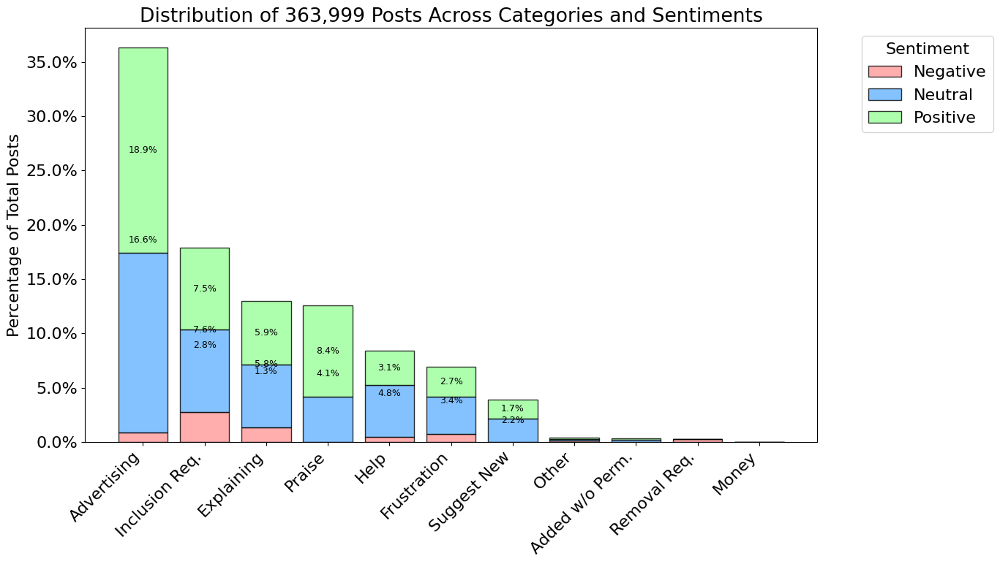

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from difflib import SequenceMatcher
from matplotlib.ticker import PercentFormatter

# File paths
file_paths = {
    "negative": "../../output_and_test_data/starter_packs/classified_negative_posts_hpc.csv",
    "neutral": "../../output_and_test_data/starter_packs/classified_neutral_posts_hpc.csv",
    "positive": "../../output_and_test_data/starter_packs/classified_positive_posts_hpc.csv"
}

# Your canonical category mapping
short_category_mapping = {
    "Frustration with the current system": "Frustration",
    "Asking for help": "Help",
    "Asking for money": "Money",
    "Asking to be removed from a starter pack": "Removal Req.",
    "Added without permission": "Added w/o Perm.",
    "Advertising a starter pack": "Advertising",
    "Desire to be included in a starter pack": "Inclusion Req.",
    "Praising a Starter Pack or Starter Packs in General": "Praise",
    "Explaining How the System Works or Reporting Starter Pack Experience": "Explaining",
    "Desire to Be Added to a Starter Pack": "Inclusion Req.",
    "Advertising a Starter Pack (including asking for members or inviting others to join)": "Advertising",
    "Expressing Frustration with the Current System (e.g., mass follow but zero engagement)": "Frustration",
    "Added Without Permission": "Added w/o Perm.",
    "Suggesting Someone Create a New Starter Pack": "Suggest New",
    "Asking for Help (e.g., understanding how the system works or looking for a specific Starter Pack)": "Help",
    "Asking for money to include someone in a starter pack": "Money",
    "Other": "Other",
    "Unknown": "Other"
}

def map_to_short_category(category_text):
    """Map raw category text to your standardized short categories"""
    category_text = str(category_text).strip().lower()
    
    # First try exact matching
    for full_desc, short_cat in short_category_mapping.items():
        if full_desc.lower() == category_text:
            return short_cat
    
    # Then try partial matching
    for full_desc, short_cat in short_category_mapping.items():
        if full_desc.lower() in category_text:
            return short_cat
    
    # Then try fuzzy matching
    for full_desc, short_cat in short_category_mapping.items():
        if SequenceMatcher(None, full_desc.lower(), category_text).ratio() > 0.8:
            return short_cat
    
    return "Other"

# Process all files and extract categories
all_data = []
for post_type, file_path in file_paths.items():
    try:
        data = pd.read_csv(file_path)
        print(f"Loaded {len(data)} {post_type} posts from {file_path}")
        
        # Map raw categories to your standardized categories
        data['mapped_category'] = data['category'].apply(map_to_short_category)
        data['post_type'] = post_type
        all_data.append(data[['mapped_category', 'post_type']])
    except Exception as e:
        print(f"Error processing {file_path}: {str(e)}")

# Combine all data
if not all_data:
    raise ValueError("No data was loaded - please check file paths")
    
df = pd.concat(all_data)
total_posts = len(df)
print(f"\nTotal posts processed: {total_posts}")

# Verify we have all categories from your mapping
missing_categories = set(short_category_mapping.values()) - set(df['mapped_category'].unique())
if missing_categories:
    print(f"\nNote: These categories had zero posts: {missing_categories}")

# Create pivot table for visualization
pivot_table = pd.pivot_table(
    df,
    index='mapped_category',
    columns='post_type',
    aggfunc='size',
    fill_value=0
)

# Convert counts to percentages
pivot_percent = pivot_table / total_posts * 100

# Sort by total percentage (sum across post types)
pivot_percent['total'] = pivot_percent.sum(axis=1)
pivot_percent = pivot_percent.sort_values('total', ascending=False)
pivot_percent = pivot_percent.drop(columns='total')

# Visualization
plt.figure(figsize=(14, 8))
colors = {
    'negative': '#ff9999',  # light red
    'neutral': '#66b3ff',   # light blue
    'positive': '#99ff99'   # light green
}

# Create stacked bars
bottom = np.zeros(len(pivot_percent.index))
for post_type in ['negative', 'neutral', 'positive']:
    if post_type in pivot_percent.columns:
        plt.bar(
            pivot_percent.index,
            pivot_percent[post_type],
            label=post_type.capitalize(),
            bottom=bottom,
            color=colors[post_type],
            edgecolor='black',
            alpha=0.8
        )
        bottom += pivot_percent[post_type].values

# Add percentage labels
for i, category in enumerate(pivot_percent.index):
    for post_type in ['negative', 'neutral', 'positive']:
        if post_type in pivot_percent.columns:
            value = pivot_percent.loc[category, post_type]
            if value > 1:  # Only show labels >1%
                y_pos = bottom[i] - pivot_percent.loc[category, post_type:].sum()/2
                plt.text(
                    i, y_pos, f"{value:.1f}%", 
                    ha='center', va='center', 
                    color='black', fontsize=9
                )

# Formatting
plt.gca().yaxis.set_major_formatter(PercentFormatter(100))
plt.xticks(rotation=45, ha='right')
plt.ylabel('Percentage of Total Posts')
plt.title(f'Distribution of {total_posts:,} Posts Across Categories and Sentiments')
plt.legend(title='Sentiment', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

In [17]:
import pandas as pd

# File paths
file_paths = {
    "negative": "../../output_and_test_data/starter_packs/classified_negative_posts_hpc.csv",
    "neutral": "../../output_and_test_data/starter_packs/classified_neutral_posts_hpc.csv",
    "positive": "../../output_and_test_data/starter_packs/classified_positive_posts_hpc.csv"
}

# Read all data into a single DataFrame
all_data = []
for post_type, file_path in file_paths.items():
    data = pd.read_csv(file_path)
    data['post_type'] = post_type  # Add post type as a column
    all_data.append(data)  # Append the full row for each file


# Combine data into one DataFrame
df = pd.concat(all_data)

# Sample 500 random posts from the entire dataset
random_sample = df.sample(n=500, random_state=42)  # Use random_state for reproducibility

# Save the random sample to a CSV file for verification
random_sample.to_csv("../../output_and_test_data/starter_packs/random_sample_500_posts.csv", index=False)

# Display a sample of the 500 random posts
print(random_sample.head())

                                     did           rkey  \
57971   did:plc:msq4ooosofe2drsfsib6txjb  3lb6mwg7lbk25   
66382   did:plc:usvybsgelkzjm5ke4kbafcyv  3ldepr2rkcs2m   
133318  did:plc:y7ekeiqnnley2bj7vxiykusa  3laoyovjeo62o   
23664   did:plc:2m6kzgo2oyystdurqxbfhnep  3lbmlb5qajg2d   
34158   did:plc:sx236tisrnpevveftixu53cs  3lbz2vpu5mk24   

                                                post_text  \
57971   Followed you, would you please Follow Me Back?...   
66382   Thanks to whomever added me to their starter p...   
133318  Is there a way to see if you're in any starter...   
23664   Now following all these academics in European ...   
34158   Trying out the Starter Pack function....pretty...   

                                                 category post_type  
57971   4. Advertising a Starter Pack (including askin...  positive  
66382   5. Expressing Frustration with the Current Sys...   neutral  
133318  8. Asking for Help (e.g., understanding how th...   neutral 